In [38]:
!git config --global user.name "JosephGrob"
!git config --global user.email "grob.j1890@gmail.com"


In [2]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# Import pandas
import pandas as pd

# Define the path to my files in Google Drive
path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/"

Mounted at /content/drive


In [3]:
import pandas as pd

# List of the files for each year
files = {
    "2016": "table_2016_DEF.xlsx",
    "2017": "table_2017_DEF.xlsx",
    "2018": "table_2018_DEF.xlsx",
    "2019": "table_2019_DEF.xlsx",
    "2021": "table_2021_DEF.xlsx"
}

# Define the path to my files in Google Drive
path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/"

# Dictionary to store the DataFrames
dataframes = {}

# Read files and add suffixes by year
for year, file in files.items():
    # Construct the full file path using the 'path' variable
    full_file_path = path + file
    df = pd.read_excel(full_file_path)
    # Normalize the 'id_def' columns
    if 'ID_DEF' in df.columns:
        df.rename(columns={'ID_DEF': 'id_def'}, inplace=True)
    elif 'Id_def' in df.columns:
        df.rename(columns={'Id_def': 'id_def'}, inplace=True)

    # Add a suffix to columns other than 'id_def'
    df = df.rename(columns={col: f"{col}_{year}" for col in df.columns if col != 'id_def'})

    # Store the modified DataFrame
    dataframes[year] = df

# Merge the DataFrames on 'id_def'
merged_df = dataframes["2016"]
for year in ["2017", "2018", "2019", "2021"]:
    merged_df = pd.merge(merged_df, dataframes[year], on='id_def', how='outer')

# Save the final DataFrame
merged_df.to_excel("merged_tables_with_years.xlsx", index=False)



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3150 entries, 0 to 3149
Columns: 127 entries, id_def to Income Ratio_2021
dtypes: float64(113), int64(1), object(13)
memory usage: 3.1+ MB
None
             id_def  % Adults Reporting Currently Smoking_2016  \
count   3150.000000                                3142.000000   
mean   30341.640000                                  17.872612   
std    15200.370413                                   3.660079   
min     1001.000000                                   6.735433   
25%    18169.500000                                  15.235070   
50%    29172.000000                                  17.320893   
75%    45080.500000                                  20.280274   
max    56045.000000                                  42.754056   

       percentage_obesity_2016  Food Environment Index_2016  \
count              3142.000000                  3123.000000   
mean                 31.473679                     7.408421   
std                   

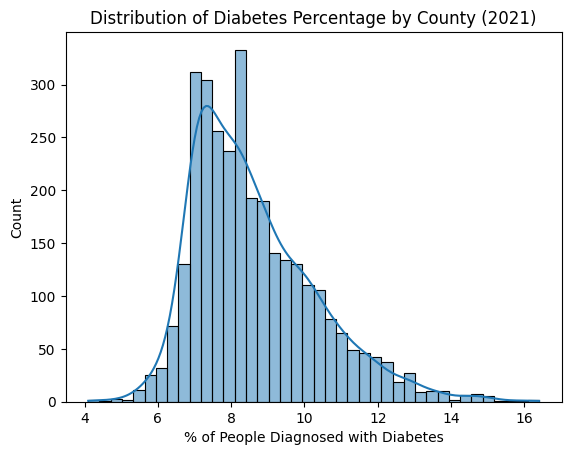

In [4]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the path
path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/"

# Load the merged data
data = pd.read_excel(path + "merged_tables_with_years.xlsx")

# Display general information about the data
print(data.info())

# Display a statistical overview of the data
print(data.describe())

# Identify the target column (diabetes) for 2021
diabetes_column = '%people diagnosticed with diabetes_2021'

# Check if the column exists
if diabetes_column in data.columns:
    # Visualize the distribution of the target variable
    sns.histplot(data[diabetes_column], kde=True)
    plt.title('Distribution of Diabetes Percentage by County (2021)')
    plt.xlabel('% of People Diagnosed with Diabetes')
    plt.show()
else:
    print(f"The column {diabetes_column} was not found in the data.")



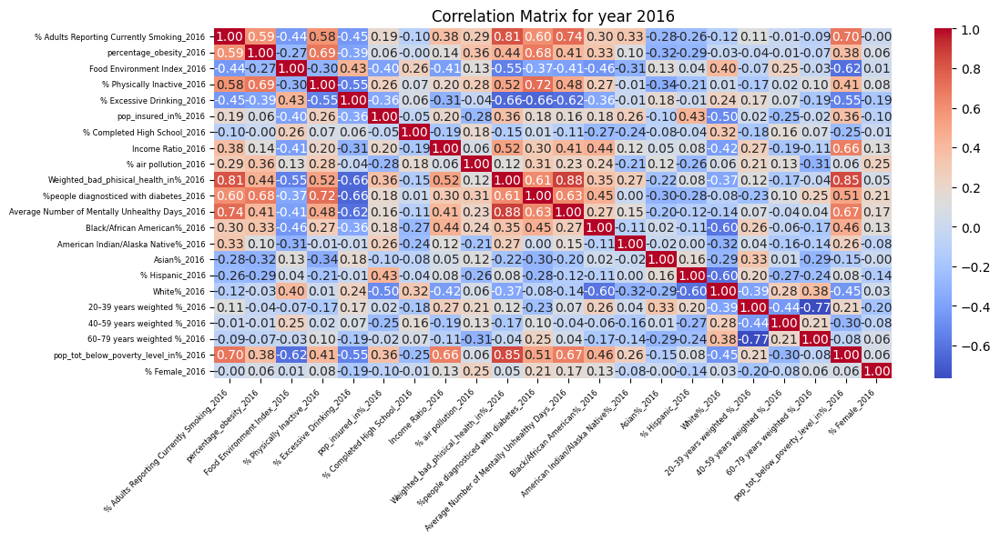

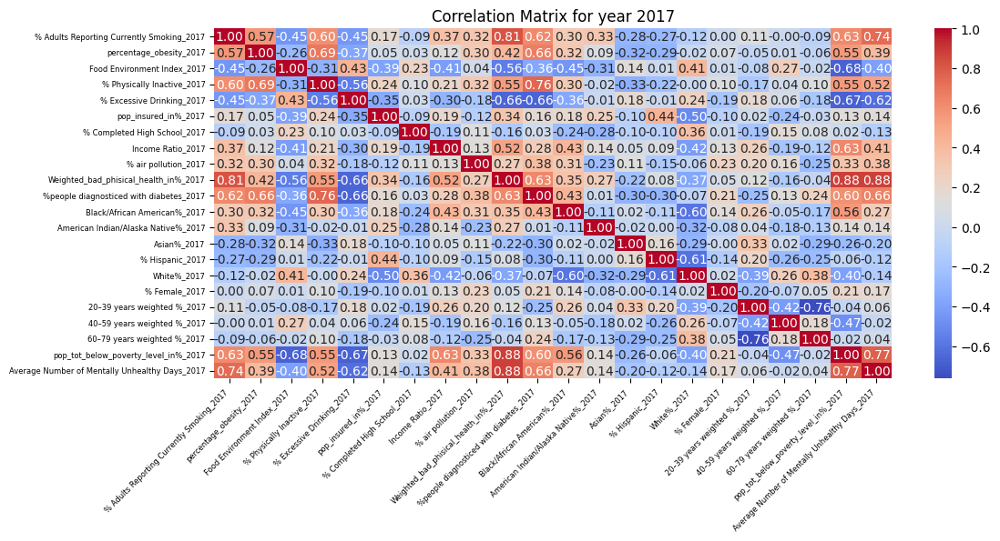

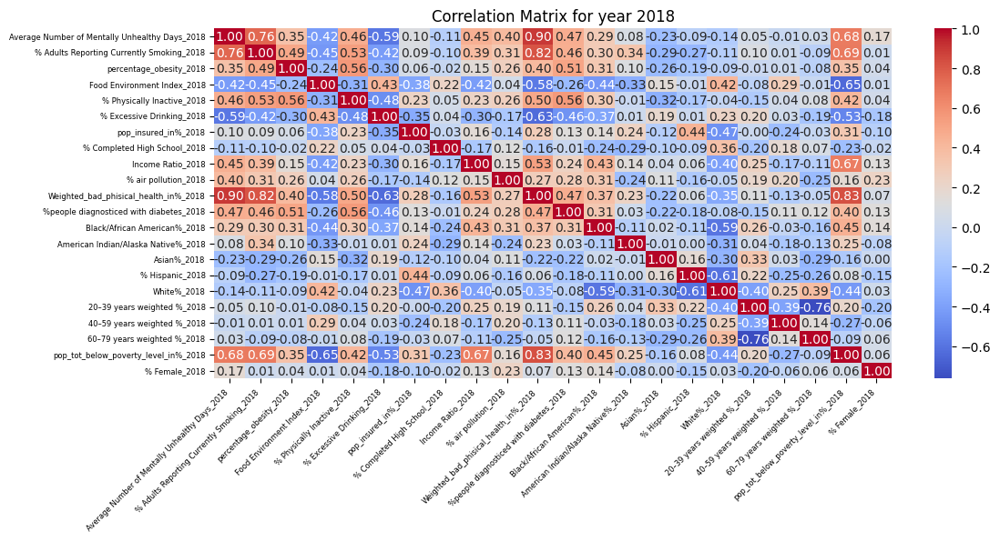

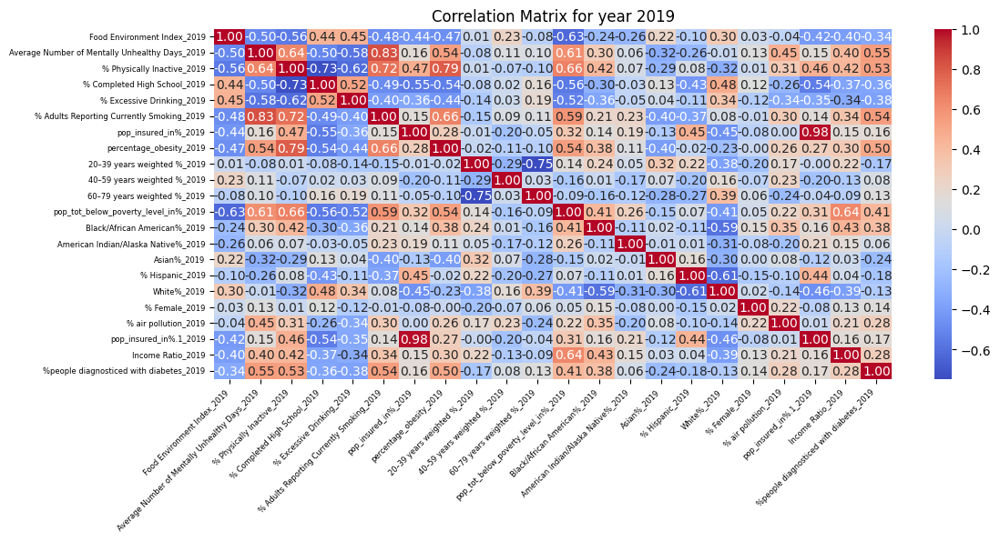

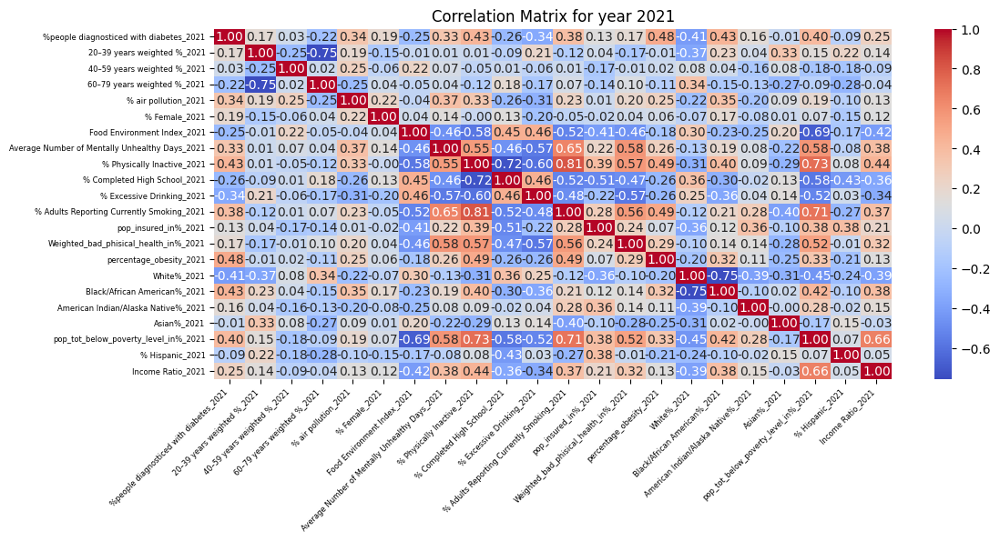

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Define the path
path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/"  # Adjust the path according to your situation

# Load the merged data
data = pd.read_excel(path + "merged_tables_with_years.xlsx")

# Extract the years from the suffixed columns
years = ['2016', '2017', '2018', '2019', '2021']  # Adjust based on the years present in your data

# Variables from 2021 to exclude
exclude_cols_2021 = ['tot_pop_2021', 'Geo Shape_2021', 'Other race%_2021', 'weighted_mobility_disability_in%_2021']

# Generate a correlation matrix for each year
for year in years:
    # Select numerical columns corresponding to the current year
    numeric_cols = [col for col in data.columns if col.endswith(f"_{year}") and data[col].dtype in ['float64', 'int64']]

    # Explicitly exclude unwanted columns from 2021
    if year == '2021':
        numeric_cols = [col for col in numeric_cols if col not in exclude_cols_2021]

    # Create a DataFrame containing only these columns
    if numeric_cols:
        year_data = data[numeric_cols]

        # Display the correlation matrix
        plt.figure(figsize=(12, 5))
        heatmap = sns.heatmap(year_data.corr(), cmap='coolwarm', annot=True, fmt=".2f")

        # Adjust font size for axis labels
        heatmap.set_xticklabels(heatmap.get_xticklabels(), fontsize=6, rotation=45, ha="right")
        heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6, rotation=0)

        plt.title(f'Correlation Matrix for year {year}')
        plt.show()
    else:
        print(f"No numeric columns found for the year {year}.")





<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


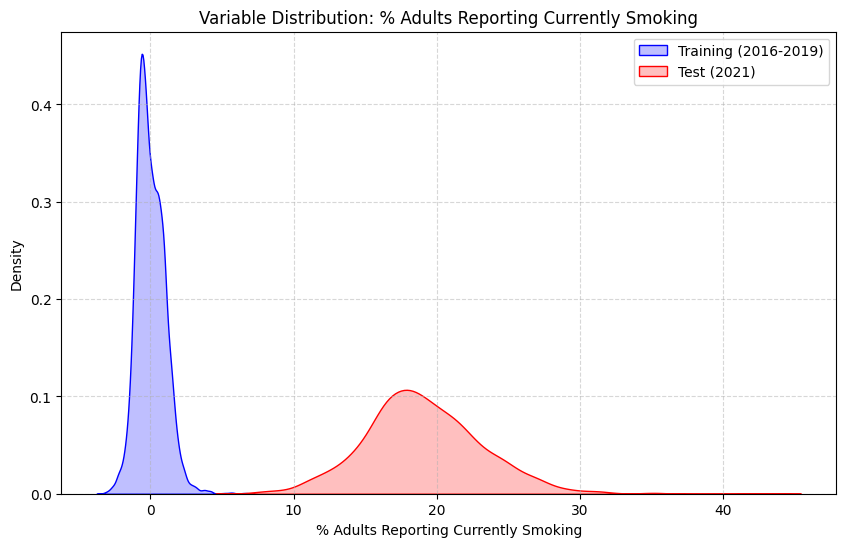

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


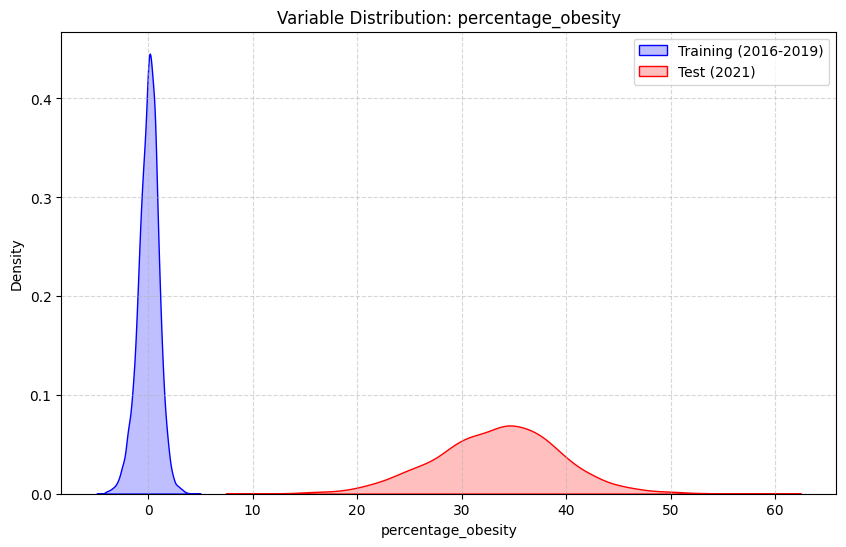

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


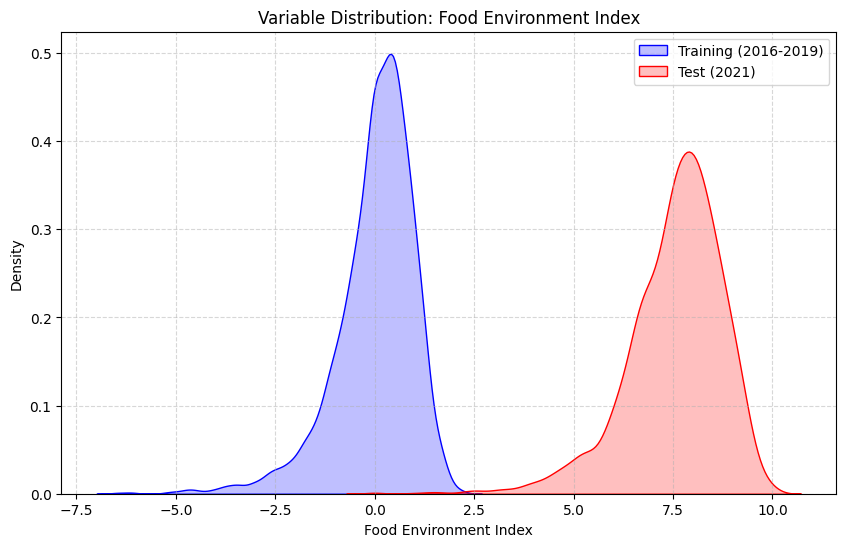

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


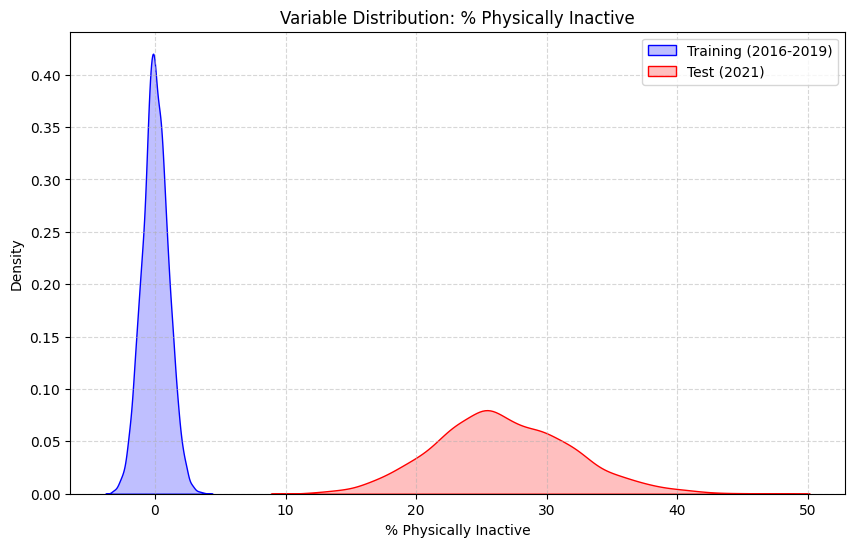

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


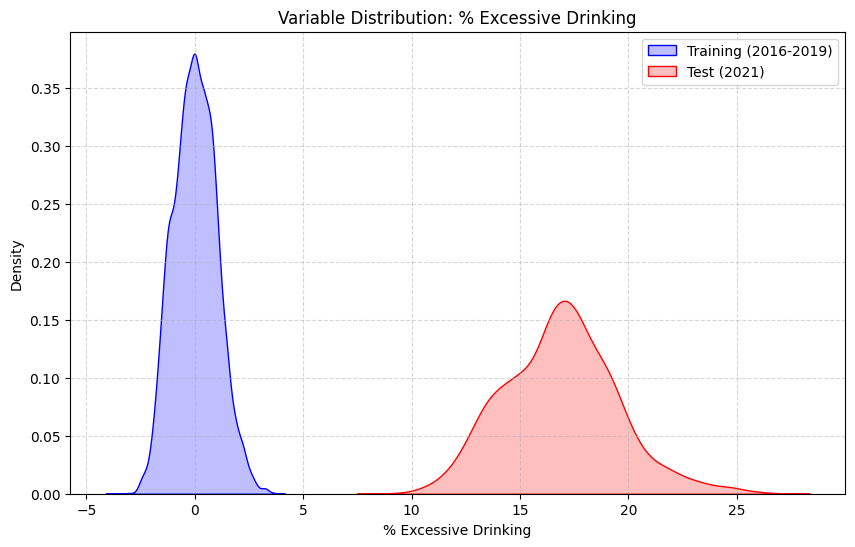

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


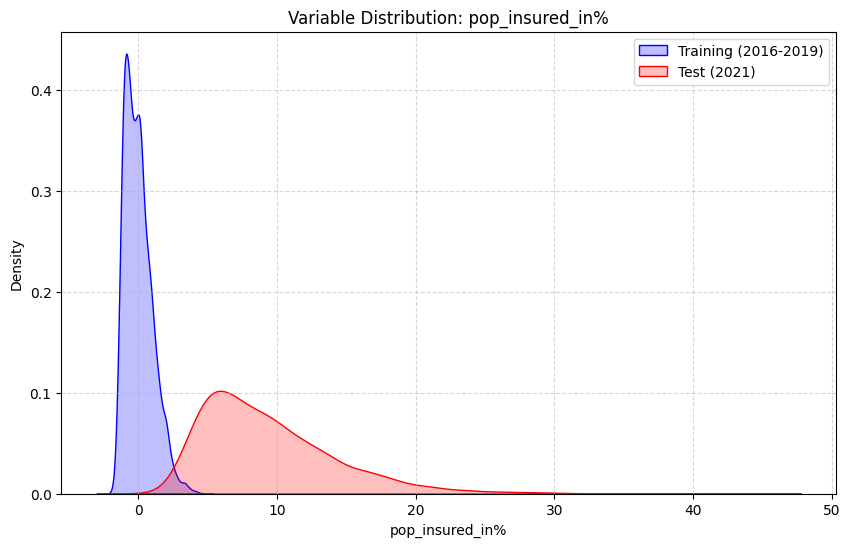

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


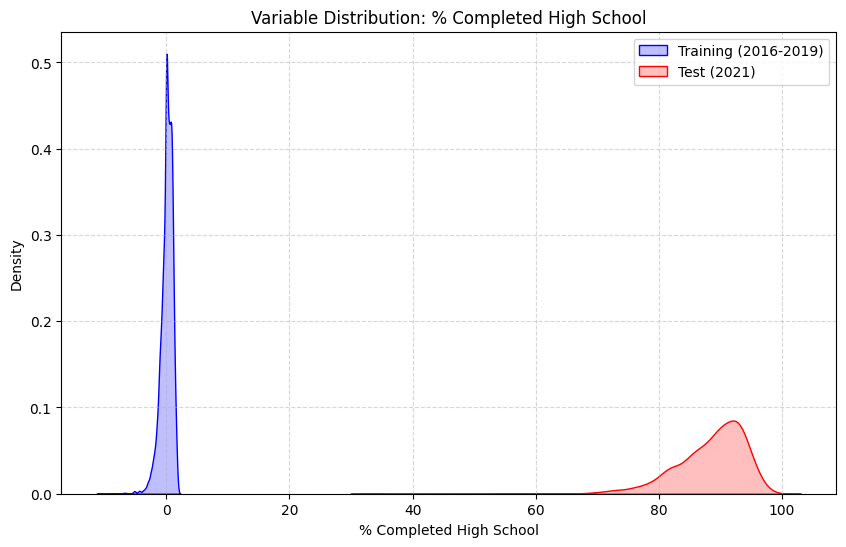

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


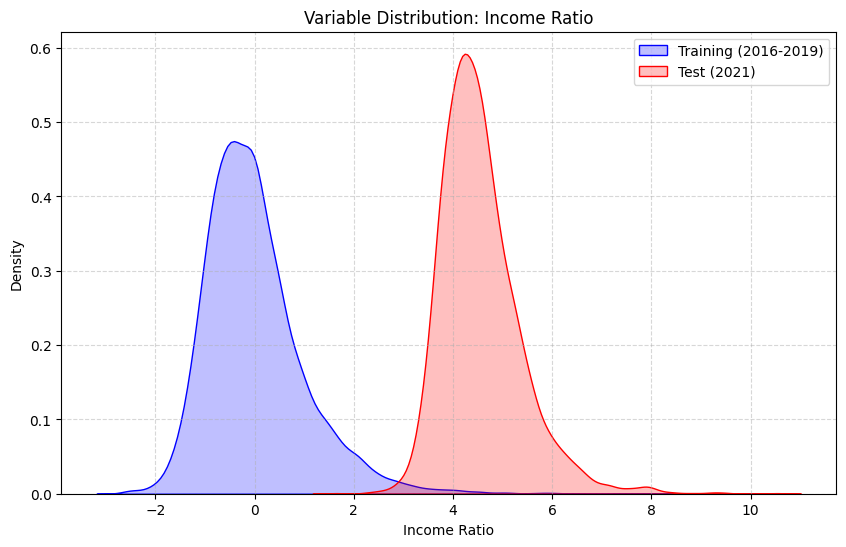

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


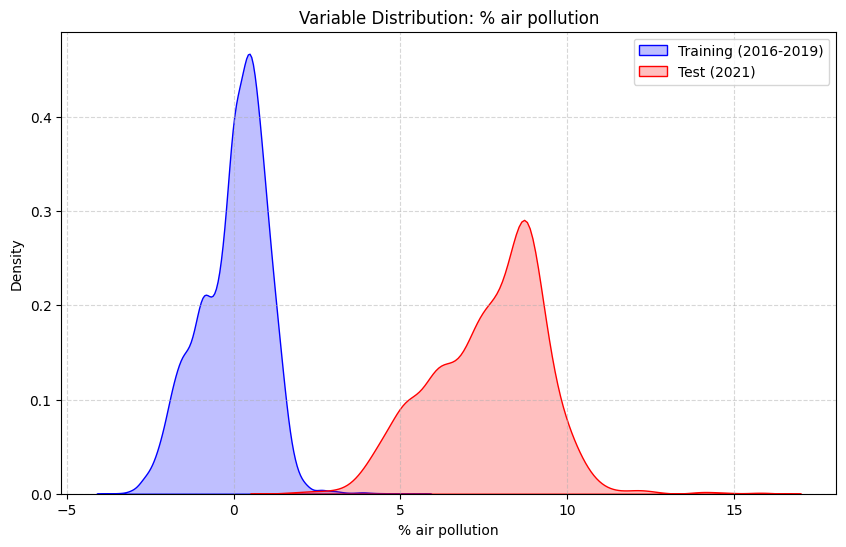

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


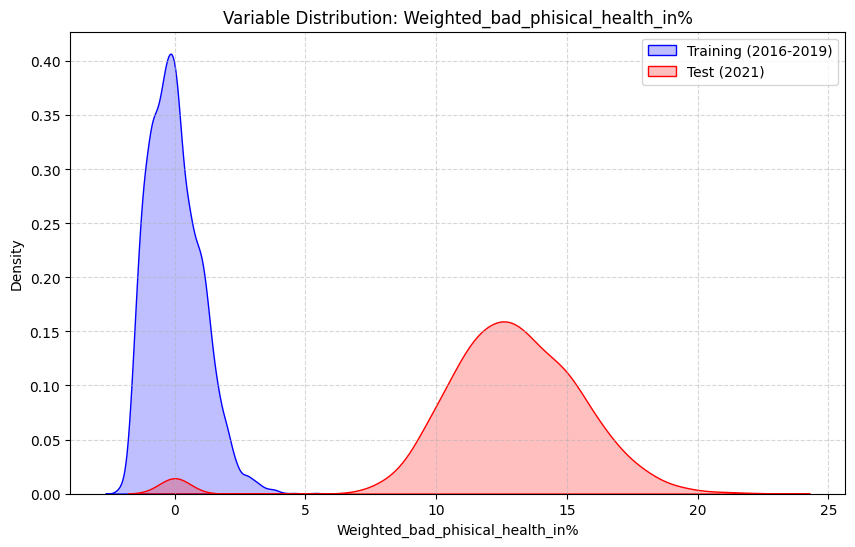

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


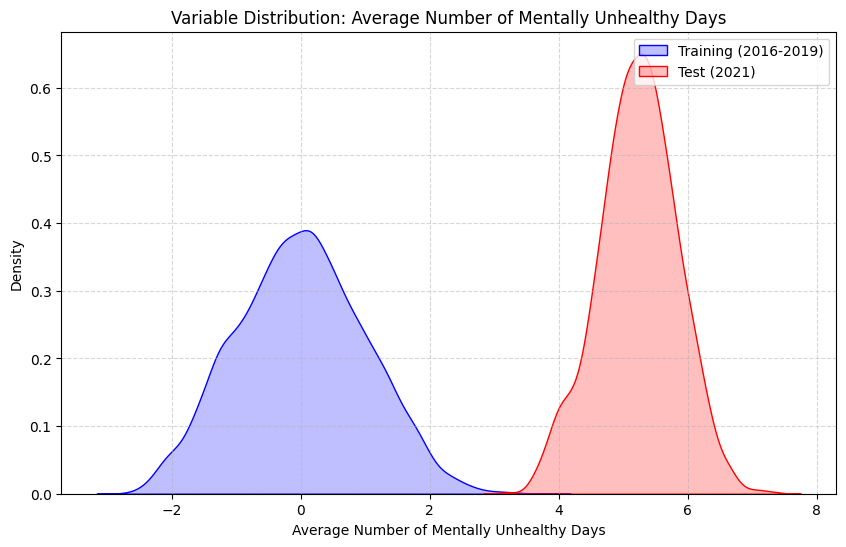

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


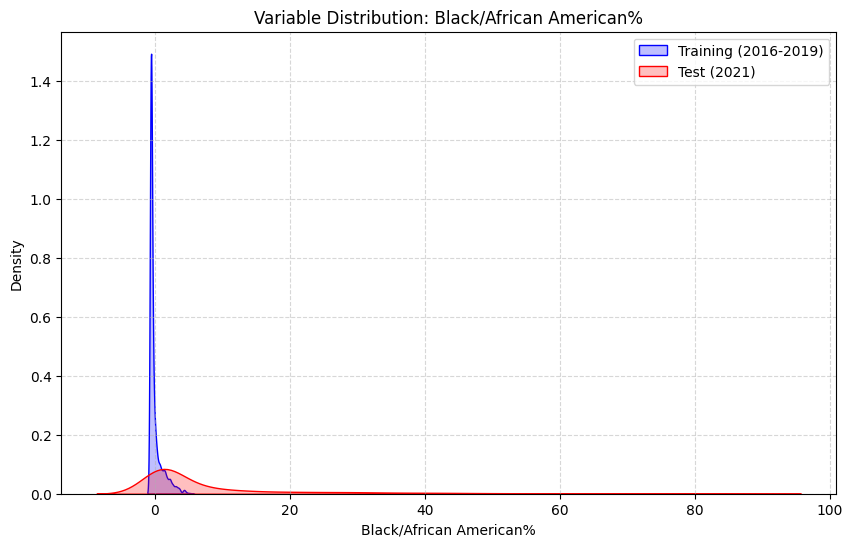

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


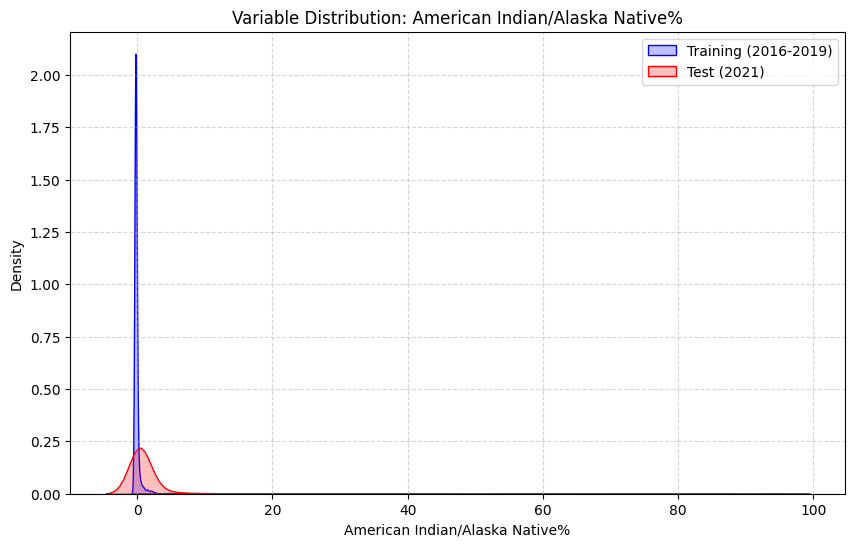

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


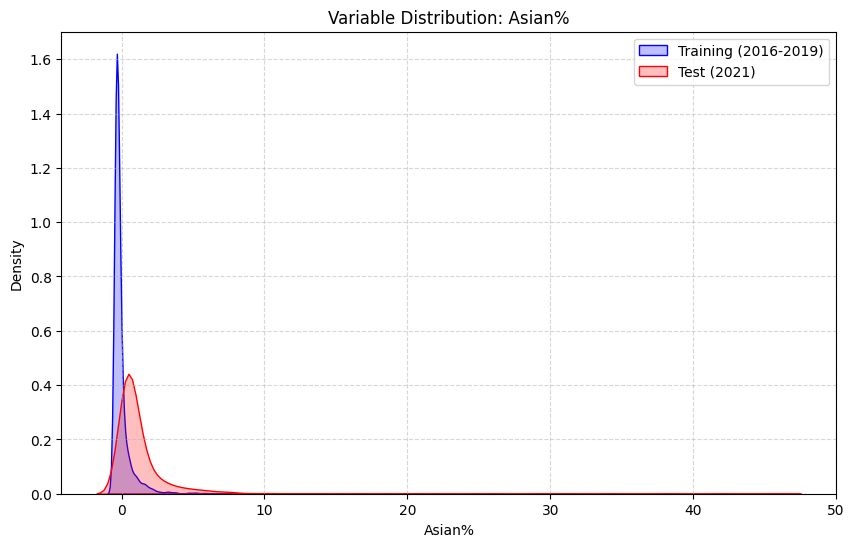

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


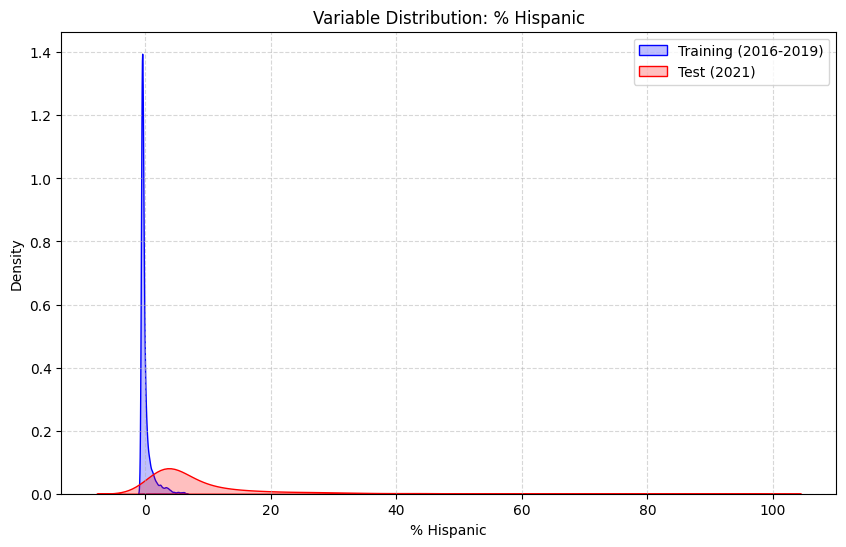

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


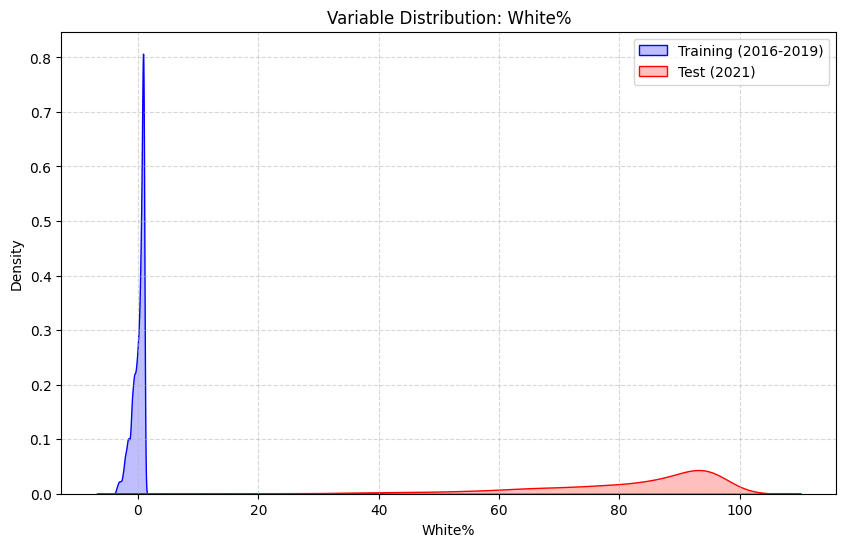

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


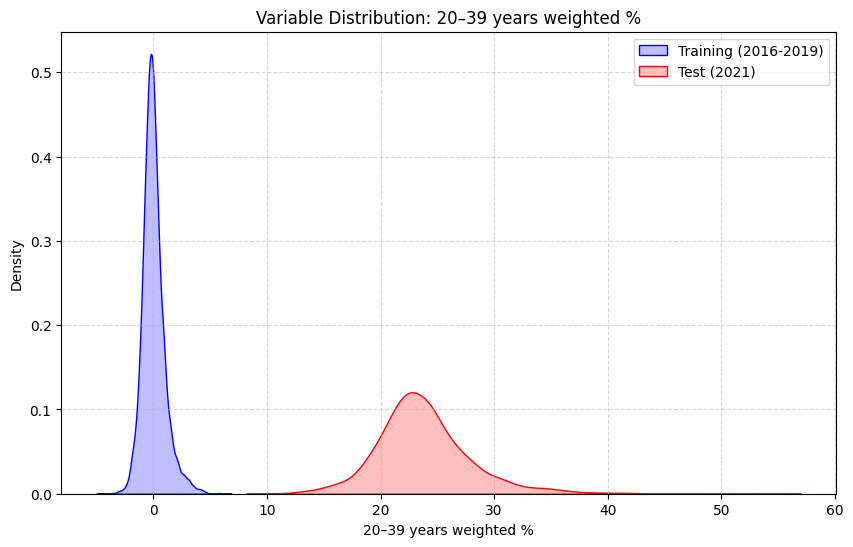

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


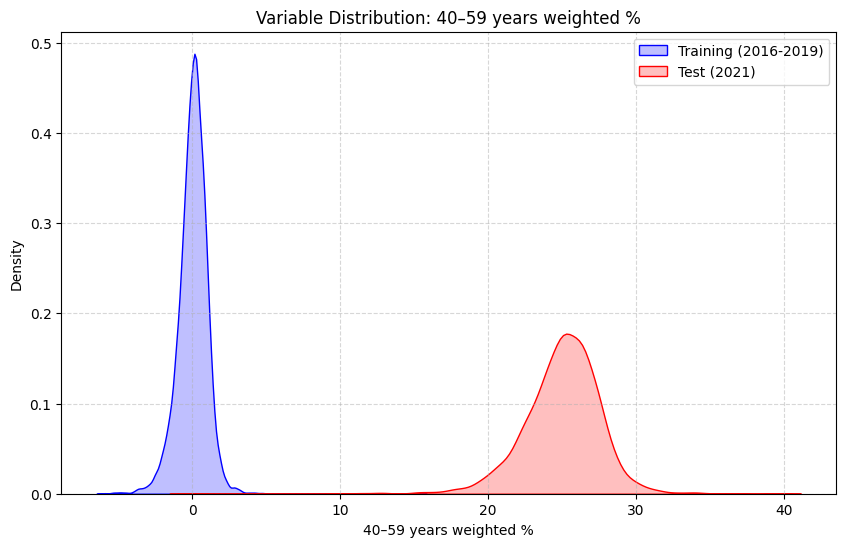

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


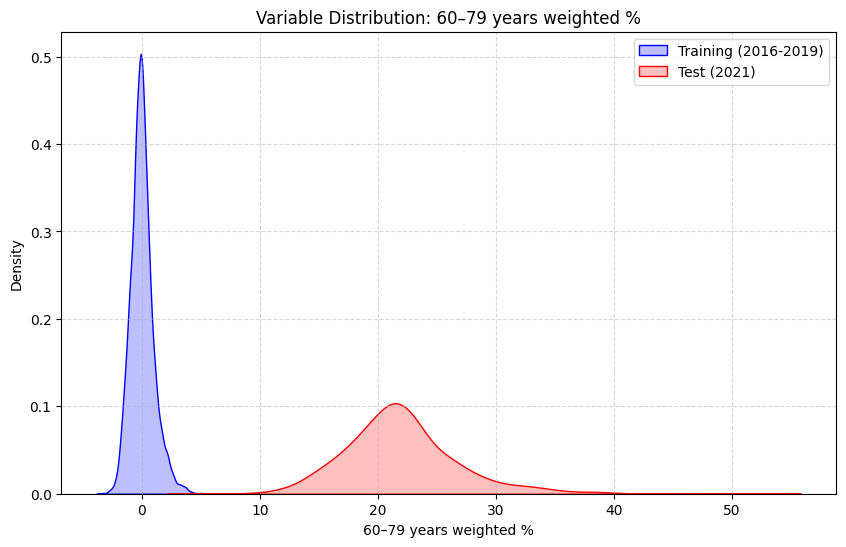

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


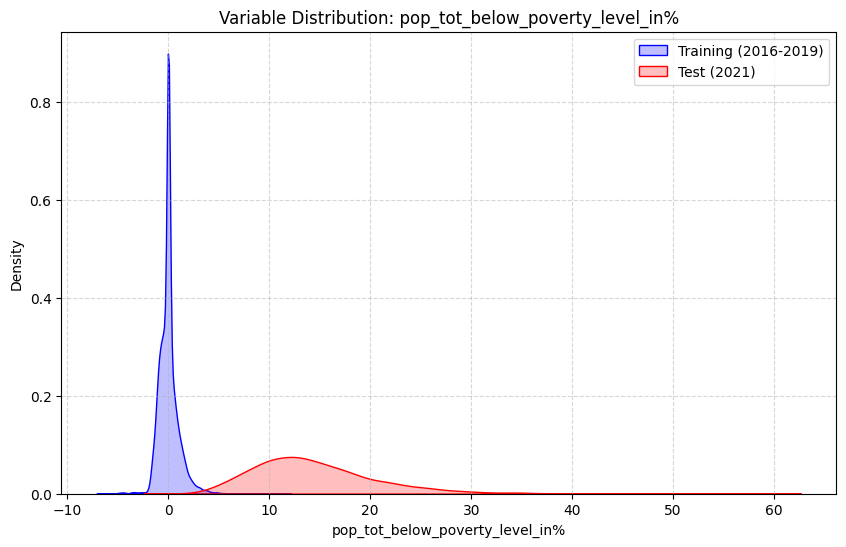

<ipython-input-6-5335cf8e91a2>:45: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')
<ipython-input-6-5335cf8e91a2>:48: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')


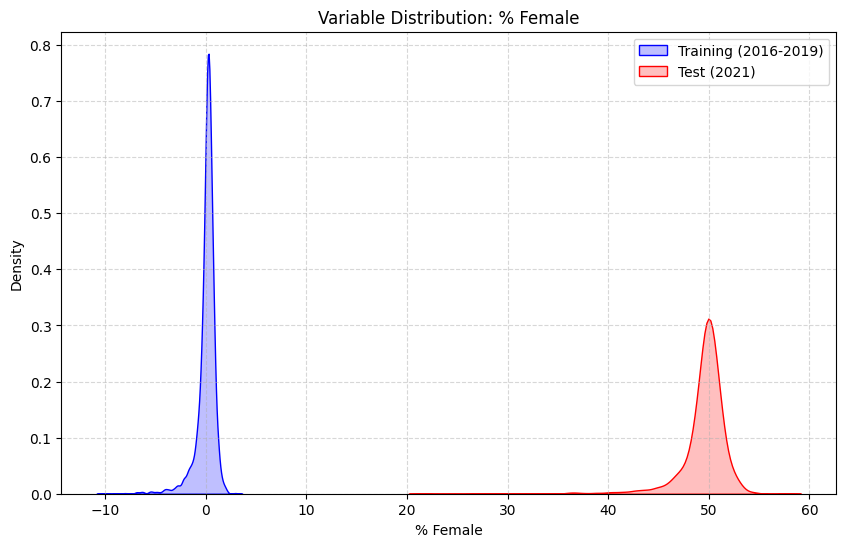

In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the cleaned and standardized dataset
data = pd.read_excel(path + "cleaned_and_standardized_train_data.xlsx")
test_data = pd.read_excel(path + "cleaned_test_data.xlsx")

# Separate the training data by year (2016-2019)
years = ['2016', '2017', '2018', '2019']
train_data_list = []

for year in years:
    # Filter columns for the current year, along with 'id_def', '%people diagnosed with diabetes', and 'tot_pop'
    year_data = data.filter(regex=f'_{year}|id_def|%people diagnosticed with diabetes|tot_pop')
    # Harmonize column names by removing the year suffix
    year_data.columns = [col.replace(f'_{year}', '') for col in year_data.columns]
    # Add the processed DataFrame for the current year to the list
    train_data_list.append(year_data)

# Merge all training years together to obtain the complete training data
train_data = pd.concat(train_data_list, ignore_index=True)

# Prepare the test data for 2021
# Harmonize column names by removing the '_2021' suffix
test_data.columns = [col.replace('_2021', '') for col in test_data.columns]

# Explicitly exclude unwanted variables from the 2021 test data
test_data = test_data.drop(columns=['Geo Shape', 'Other race%', 'weighted_mobility_disability_in%', 'tot_pop'], errors='ignore')

# Define valid numeric columns (explicit exclusion of non-numeric columns)
numeric_cols = [
    '% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
    '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
    'Weighted_bad_phisical_health_in%', 'Average Number of Mentally Unhealthy Days', 'Black/African American%',
    'American Indian/Alaska Native%', 'Asian%', '% Hispanic', 'White%', '20–39 years weighted %',
    '40–59 years weighted %', '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female',
]

# Create density plots for each numeric variable
for col in numeric_cols:
    plt.figure(figsize=(10, 6))

    # Plot density for training data
    sns.kdeplot(data=train_data[col], label='Training (2016-2019)', shade=True, color='blue')

    # Plot density for test data
    sns.kdeplot(data=test_data[col], label='Test (2021)', shade=True, color='red')

    # Add details to the plot
    plt.title(f'Variable Distribution: {col}')
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)

    # Show the plot
    plt.show()



In [7]:
import numpy as np

# Ensure that "Geo Shape", "Other race_2021%", and "weighted_mobility_disability_in%_2021" are removed from the test data before preparation
test_data = test_data.drop(columns=['Geo Shape', 'Other race%_2021', 'weighted_mobility_disability_in%_2021'], errors='ignore')

# Define the test data
X_test = test_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
y_test = test_data['%people diagnosticed with diabetes']

# Handle missing values in the test data
X_test = X_test.replace('-', np.nan)
X_test = X_test.fillna(X_test.mean())

# Convert to numeric values after handling missing values
X_test = X_test.values.astype(np.float64)
y_test = y_test.values.astype(np.float64)

# Diagnostic to check that unwanted columns have been successfully removed
print("Columns present in the test data:", test_data.columns.tolist())



Columns present in the test data: ['id_def', 'county_x', 'state_x', '%people diagnosticed with diabetes', '20–39 years weighted %', '40–59 years weighted %', '60–79 years weighted %', '% air pollution', 'pop_18_24_with_Less_than_high_school_graduate_in%', 'median income (dollars)', '% Female', 'Food Environment Index', 'Average Number of Mentally Unhealthy Days', '% Physically Inactive', '% Completed High School', '% Excessive Drinking', '% Adults Reporting Currently Smoking', 'pop_insured_in%', 'Weighted_bad_phisical_health_in%', 'percentage_obesity', 'White%', 'Black/African American%', 'American Indian/Alaska Native%', 'Asian%', 'pop_tot_below_poverty_level_in%', '% Hispanic', 'Income Ratio']


Performance of the Linear Regression model:
R² Training: 0.6726, R² Validation: 0.6947, R² Test: 0.3866
MSE Training: 0.3271, MSE Validation: 0.3061, MSE Test: 0.6134
RMSE Training: 0.5719, RMSE Validation: 0.5533, RMSE Test: 0.7832


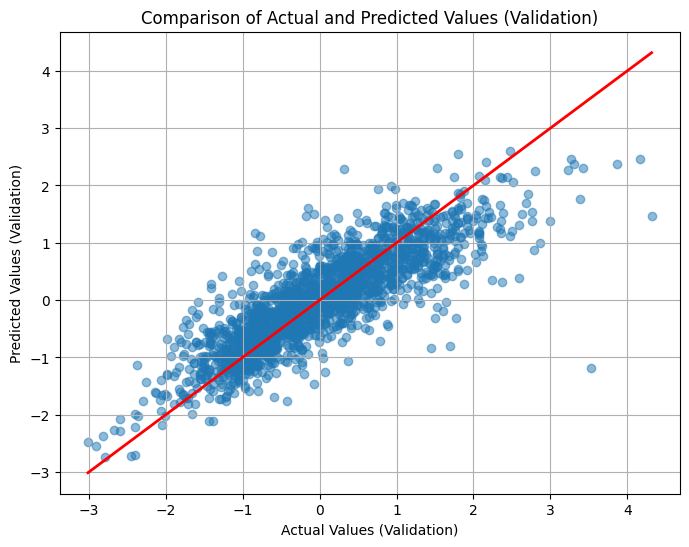

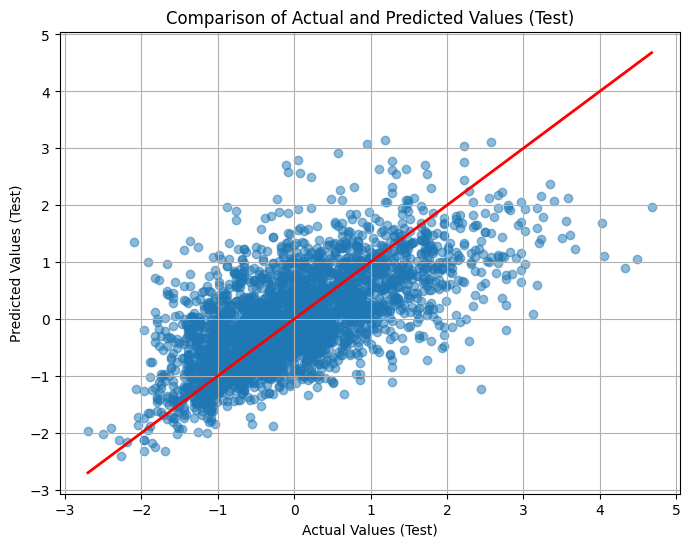

In [8]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, cross_val_score

# Load the cleaned and standardized dataset
data = pd.read_excel(path + "cleaned_and_standardized_train_data.xlsx")

# Separate training data for 2016, 2017, and 2018
train_years = ['2016', '2017', '2018']
train_data_list = []

# Extract and combine training data
for year in train_years:
    # Filter columns for the current year, along with 'id_def', '%people diagnosticed with diabetes', and 'tot_pop'
    year_data = data.filter(regex=f'_{year}|id_def|%people diagnosticed with diabetes|tot_pop')
    # Harmonize column names by removing the year suffix
    year_data.columns = [col.replace(f'_{year}', '') for col in year_data.columns]
    # Add the processed DataFrame for the current year to the list
    train_data_list.append(year_data)

# Merge training data for 2016, 2017, and 2018
train_data = pd.concat(train_data_list, ignore_index=True)

# Define valid numeric columns (explicit exclusion of non-numeric columns and "Weighted_bad_phisical_health_in%")
numeric_cols = [
    '% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
    '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
    'Average Number of Mentally Unhealthy Days', 'Black/African American%',
    'American Indian/Alaska Native%', 'Asian%', '% Hispanic', 'White%', '20–39 years weighted %',
    '40–59 years weighted %', '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female',
]


# Separate X and y in the training data
X = train_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
y = train_data['%people diagnosticed with diabetes']

# Replace missing values in the training data
X = X.replace('-', np.nan)
X = X.replace(0, np.nan)
X = X.fillna(X.mean())

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the training and validation data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
y_train = y_train.values.astype(np.float64)
y_val = y_val.values.astype(np.float64)

# Prepare the test data for the year 2019
test_data_2019 = data.filter(regex=f'_2019|id_def|%people diagnosticed with diabetes|tot_pop')
test_data_2019.columns = [col.replace('_2019', '') for col in test_data_2019.columns]

# Separate X_test and y_test for 2019
X_test = test_data_2019[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
y_test = test_data_2019['%people diagnosticed with diabetes']

# Replace missing values and zeros in the test data
X_test = X_test.replace('-', np.nan)
X_test = X_test.replace(0, np.nan)
X_test = X_test.fillna(X.mean())  # Use training means to fill NaNs

# Apply the same standardization to the test data
X_test_scaled = scaler.transform(X_test)

# Linear Regression
lin_reg = LinearRegression()

# Train the model on the training data
lin_reg.fit(X_train_scaled, y_train)

# Make predictions on the training, validation, and test sets
y_train_pred = lin_reg.predict(X_train_scaled)
y_val_pred = lin_reg.predict(X_val_scaled)
y_test_pred = lin_reg.predict(X_test_scaled)

# Calculate metrics for the training, validation, and test sets
train_r2 = r2_score(y_train, y_train_pred)
val_r2 = r2_score(y_val, y_val_pred)
test_r2 = r2_score(y_test, y_test_pred)

train_mse = mean_squared_error(y_train, y_train_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
test_mse = mean_squared_error(y_test, y_test_pred)

train_rmse = np.sqrt(train_mse)
val_rmse = np.sqrt(val_mse)
test_rmse = np.sqrt(test_mse)

# Display metrics for each set
print("Performance of the Linear Regression model:")
print(f"R² Training: {train_r2:.4f}, R² Validation: {val_r2:.4f}, R² Test: {test_r2:.4f}")
print(f"MSE Training: {train_mse:.4f}, MSE Validation: {val_mse:.4f}, MSE Test: {test_mse:.4f}")
print(f"RMSE Training: {train_rmse:.4f}, RMSE Validation: {val_rmse:.4f}, RMSE Test: {test_rmse:.4f}")

# Visualization: Comparison of actual vs. predicted values (validation)
plt.figure(figsize=(8, 6))
plt.scatter(y_val, y_val_pred, alpha=0.5)
plt.xlabel("Actual Values (Validation)")
plt.ylabel("Predicted Values (Validation)")
plt.title("Comparison of Actual and Predicted Values (Validation)")
plt.plot([y_val.min(), y_val.max()], [y_val.min(), y_val.max()], color='red', linewidth=2)
plt.grid(True)
plt.show()

# Visualization: Comparison of actual vs. predicted values (test)
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, alpha=0.5)
plt.xlabel("Actual Values (Test)")
plt.ylabel("Predicted Values (Test)")
plt.title("Comparison of Actual and Predicted Values (Test)")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], color='red', linewidth=2)
plt.grid(True)
plt.show()





Iteration with ['2017', '2018', '2019'] as training years and 2016 as validation year:
R² Training: 0.5521, R² Validation: 0.7727

Iteration with ['2016', '2018', '2019'] as training years and 2017 as validation year:
R² Training: 0.5475, R² Validation: 0.7851

Iteration with ['2016', '2017', '2019'] as training years and 2018 as validation year:
R² Training: 0.6687, R² Validation: 0.4211

Iteration with ['2016', '2017', '2018'] as training years and 2019 as validation year:
R² Training: 0.6775, R² Validation: 0.3874

Summary of R² Scores for Each Iteration:
     Training Years Validation Year  R² Training  R² Validation
0  2017, 2018, 2019            2016     0.552057       0.772669
1  2016, 2018, 2019            2017     0.547455       0.785068
2  2016, 2017, 2019            2018     0.668676       0.421085
3  2016, 2017, 2018            2019     0.677461       0.387442


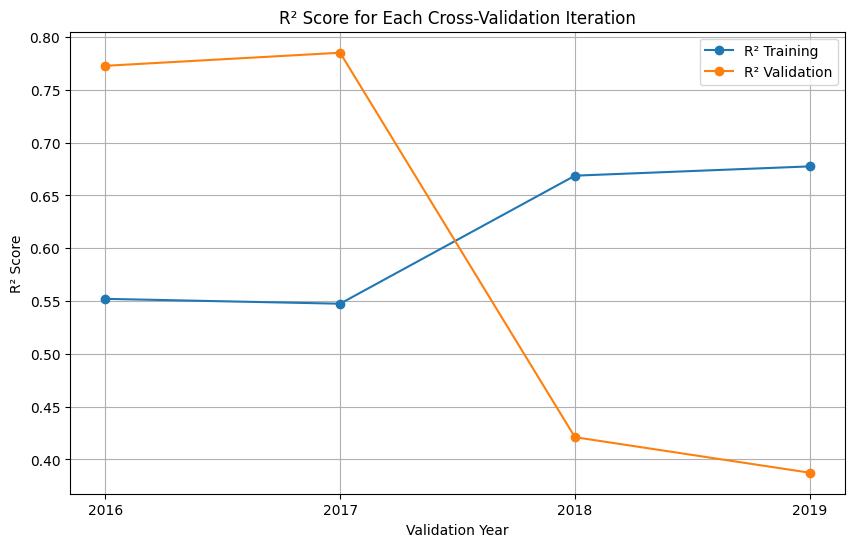

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error

# Load the cleaned and standardized dataset
data = pd.read_excel(path + "cleaned_and_standardized_train_data.xlsx")

# Define the years for training and cross-validation
years = ['2016', '2017', '2018', '2019']

# Valid numeric columns
numeric_cols = [
    '% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
    '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
    'Average Number of Mentally Unhealthy Days', 'Black/African American%',
    'American Indian/Alaska Native%', 'Asian%', '% Hispanic', 'White%', '20–39 years weighted %',
    '40–59 years weighted %', '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female',
]

# Initialize lists to store R² scores
train_r2_scores = []
val_r2_scores = []

# Loop through the years to create combinations of 3 training years and 1 validation year
for i in range(len(years)):
    # Select the training and validation years for this iteration
    train_years = [year for j, year in enumerate(years) if j != i]
    val_year = years[i]

    # Prepare the training data
    train_data_list = []
    for year in train_years:
        year_data = data.filter(regex=f'_{year}|id_def|%people diagnosticed with diabetes|tot_pop')
        year_data.columns = [col.replace(f'_{year}', '') for col in year_data.columns]
        train_data_list.append(year_data)
    train_data = pd.concat(train_data_list, ignore_index=True)

    # Prepare the validation data
    val_data = data.filter(regex=f'_{val_year}|id_def|%people diagnosticed with diabetes|tot_pop')
    val_data.columns = [col.replace(f'_{val_year}', '') for col in val_data.columns]

    # Separate X_train, y_train, X_val, and y_val
    X_train = train_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
    y_train = train_data['%people diagnosticed with diabetes']
    X_val = val_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
    y_val = val_data['%people diagnosticed with diabetes']

    # Replace missing values
    X_train = X_train.replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())
    X_val = X_val.replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())  # Use training means for consistency

    # Standardize the data
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    y_train = y_train.values.astype(np.float64)
    y_val = y_val.values.astype(np.float64)

    # Train the model
    lin_reg = LinearRegression()
    lin_reg.fit(X_train_scaled, y_train)

    # Calculate predictions and R² scores for training and validation
    y_train_pred = lin_reg.predict(X_train_scaled)
    y_val_pred = lin_reg.predict(X_val_scaled)

    train_r2 = r2_score(y_train, y_train_pred)
    val_r2 = r2_score(y_val, y_val_pred)

    train_r2_scores.append(train_r2)
    val_r2_scores.append(val_r2)

    print(f"Iteration with {train_years} as training years and {val_year} as validation year:")
    print(f"R² Training: {train_r2:.4f}, R² Validation: {val_r2:.4f}\n")

# Summary of scores
results = pd.DataFrame({
    'Training Years': [', '.join([y for j, y in enumerate(years) if j != i]) for i in range(len(years))],
    'Validation Year': years,
    'R² Training': train_r2_scores,
    'R² Validation': val_r2_scores
})

print("Summary of R² Scores for Each Iteration:")
print(results)

# Visualization of scores
plt.figure(figsize=(10, 6))
plt.plot(years, train_r2_scores, marker='o', label='R² Training')
plt.plot(years, val_r2_scores, marker='o', label='R² Validation')
plt.xlabel("Validation Year")
plt.ylabel("R² Score")
plt.title("R² Score for Each Cross-Validation Iteration")
plt.legend()
plt.grid(True)
plt.show()



Summary of R² scores for each model year combination:
     Training Years Validation Year  R² Score
0  2017, 2018, 2019            2016  0.772669
1  2016, 2018, 2019            2017  0.785068
2  2016, 2017, 2019            2018  0.421085
3  2016, 2017, 2018            2019  0.387442


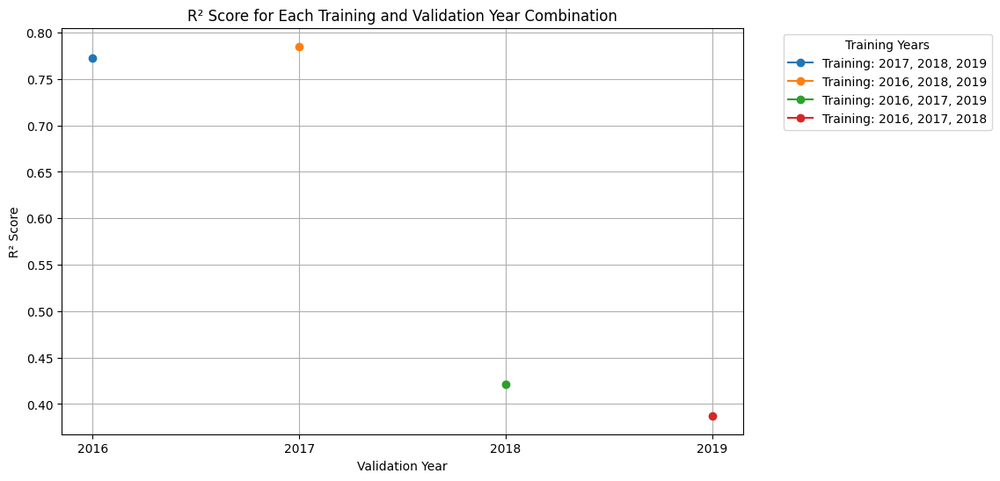

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Load the cleaned and standardized dataset
data = pd.read_excel(path + "cleaned_and_standardized_train_data.xlsx")

# Define the years for training and cross-validation
years = ['2016', '2017', '2018', '2019']

# Valid numeric columns
numeric_cols = [
    '% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
    '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
    'Average Number of Mentally Unhealthy Days', 'Black/African American%',
    'American Indian/Alaska Native%', 'Asian%', '% Hispanic', 'White%', '20–39 years weighted %',
    '40–59 years weighted %', '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female',
]

# Initialize a list to store the results
results = []

# Loop over the years to create combinations of 3 training and 1 validation
for i in range(len(years)):
    # Select training and validation years for this iteration
    train_years = [year for j, year in enumerate(years) if j != i]
    val_year = years[i]

    # Prepare training data
    train_data_list = []
    for year in train_years:
        year_data = data.filter(regex=f'_{year}|id_def|%people diagnosticed with diabetes|tot_pop')
        year_data.columns = [col.replace(f'_{year}', '') for col in year_data.columns]
        train_data_list.append(year_data)
    train_data = pd.concat(train_data_list, ignore_index=True)

    # Prepare validation data
    val_data = data.filter(regex=f'_{val_year}|id_def|%people diagnosticed with diabetes|tot_pop')
    val_data.columns = [col.replace(f'_{val_year}', '') for col in val_data.columns]

    # Separate X_train, y_train, X_val, and y_val
    X_train = train_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
    y_train = train_data['%people diagnosticed with diabetes']
    X_val = val_data[numeric_cols].drop(columns=['%people diagnosticed with diabetes'], errors='ignore')
    y_val = val_data['%people diagnosticed with diabetes']

    # Replace missing values
    X_train = X_train.replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())
    X_val = X_val.replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())

    # Standardize the data
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    y_train = y_train.values.astype(np.float64)
    y_val = y_val.values.astype(np.float64)

    # Train the model
    lin_reg = LinearRegression()
    lin_reg.fit(X_train_scaled, y_train)

    # Calculate predictions and R² scores for validation
    y_val_pred = lin_reg.predict(X_val_scaled)
    val_r2 = r2_score(y_val, y_val_pred)

    # Store the results
    results.append({
        'Training Years': ', '.join(train_years),
        'Validation Year': val_year,
        'R² Score': val_r2
    })

# Convert the results into a DataFrame for better visualization
results_df = pd.DataFrame(results)

# Display the results
print("Summary of R² scores for each model year combination:")
print(results_df)

# Visualization of scores by validation year
plt.figure(figsize=(10, 6))
for train_years in results_df['Training Years'].unique():
    subset = results_df[results_df['Training Years'] == train_years]
    plt.plot(subset['Validation Year'], subset['R² Score'], marker='o', label=f'Training: {train_years}')

plt.xlabel("Validation Year")
plt.ylabel("R² Score")
plt.title("R² Score for Each Training and Validation Year Combination")
plt.legend(title="Training Years", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()






In [11]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split  # Import for validation splitting

# Load the data and prepare the columns
data = pd.read_excel(path + "cleaned_and_standardized_train_data.xlsx")
train_years = ['2016', '2017', '2018']
test_year = '2019'

# Valid numeric columns
numeric_cols = [
    '% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
    '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
    'Average Number of Mentally Unhealthy Days', 'Black/African American%', 'American Indian/Alaska Native%',
    'Asian%', '% Hispanic', 'White%', '20–39 years weighted %', '40–59 years weighted %',
    '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female'
]

# Prepare the training data for the specified years
train_data_list = []
for year in train_years:
    year_data = data.filter(regex=f'_{year}|id_def|%people diagnosticed with diabetes|tot_pop')
    year_data.columns = [col.replace(f'_{year}', '') for col in year_data.columns]
    train_data_list.append(year_data)
train_data = pd.concat(train_data_list, ignore_index=True)

# Separate X_train and y_train
X_train = train_data[numeric_cols].replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())
y_train = train_data['%people diagnosticed with diabetes']


# Addition: Splitting the training and validation sets
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Reset indices to ensure alignment
X_train_final = X_train_final.reset_index(drop=True)
y_train_final = y_train_final.reset_index(drop=True)

X_val = X_val.reset_index(drop=True)
y_val = y_val.reset_index(drop=True)

# Prepare the test data for the specified year (2019)
test_data = data.filter(regex=f'_{test_year}|id_def|%people diagnosticed with diabetes|tot_pop')
test_data.columns = [col.replace(f'_{test_year}', '') for col in test_data.columns]

# Separate X_test and y_test
X_test = test_data[numeric_cols].replace('-', np.nan).replace(0, np.nan)

# Replace missing values in X_test with means calculated on X_train_final
X_test = X_test.fillna(X_train_final.mean())
y_test = test_data['%people diagnosticed with diabetes']

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_final)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

# Recreate an aligned DataFrame for final training
X_train_df = pd.DataFrame(X_train_scaled, columns=numeric_cols)
X_train_df = X_train_df.reset_index(drop=True)

# Forward selection function using AIC/BIC
def forward_selection_aic_bic(X, y, criterion='AIC'):
    initial_features = []
    remaining_features = list(X.columns)
    best_features = []
    best_criterion_value = np.inf

    while remaining_features:
        criterion_values = []
        for feature in remaining_features:
            model = sm.OLS(y, sm.add_constant(X[initial_features + [feature]])).fit()
            if criterion == 'AIC':
                criterion_value = model.aic
            elif criterion == 'BIC':
                criterion_value = model.bic
            criterion_values.append((criterion_value, feature))

        criterion_values.sort()
        new_criterion_value, best_feature = criterion_values[0]

        if best_criterion_value - new_criterion_value > 0:  # Continue as long as the criterion improves
            best_criterion_value = new_criterion_value
            initial_features.append(best_feature)
            remaining_features.remove(best_feature)
            best_features.append(best_feature)
        else:
            break

    return best_features, best_criterion_value

# Run forward selection with AIC
selected_features_aic, aic_value = forward_selection_aic_bic(X_train_df, y_train_final, criterion='AIC')
print("Features selected with AIC:", selected_features_aic)
print("AIC value of the model:", aic_value)

# Run forward selection with BIC
selected_features_bic, bic_value = forward_selection_aic_bic(X_train_df, y_train_final, criterion='BIC')
print("Features selected with BIC:", selected_features_bic)
print("BIC value of the model:", bic_value)

# Fit the linear regression model with features selected by AIC
X_aic_selected = X_train_df[selected_features_aic]
X_aic_selected = sm.add_constant(X_aic_selected)
model_aic = sm.OLS(y_train_final, X_aic_selected).fit()

# Summary of the AIC model
print("\nSummary of the model with features selected by AIC:")
print(model_aic.summary())

# Fit the linear regression model with features selected by BIC
X_bic_selected = X_train_df[selected_features_bic]
X_bic_selected = sm.add_constant(X_bic_selected)
model_bic = sm.OLS(y_train_final, X_bic_selected).fit()

# Summary of the BIC model
print("\nSummary of the model with features selected by BIC:")
print(model_bic.summary())





Features selected with AIC: ['% Physically Inactive', 'Average Number of Mentally Unhealthy Days', 'percentage_obesity', '60–79 years weighted %', 'Black/African American%', '% Excessive Drinking', '40–59 years weighted %', '% air pollution', 'American Indian/Alaska Native%', '% Female', '% Completed High School', 'Food Environment Index', 'Income Ratio', '% Adults Reporting Currently Smoking', 'pop_insured_in%', 'White%', '20–39 years weighted %']
AIC value of the model: 13047.115343466978
Features selected with BIC: ['% Physically Inactive', 'Average Number of Mentally Unhealthy Days', 'percentage_obesity', '60–79 years weighted %', 'Black/African American%', '% Excessive Drinking', '40–59 years weighted %', '% air pollution', 'American Indian/Alaska Native%', '% Female', '% Completed High School', 'Food Environment Index', 'Income Ratio']
BIC value of the model: 13154.529056017633

Summary of the model with features selected by AIC:
                                    OLS Regression

In [12]:
print("Dimensions de X_train :", X_train.shape)
print("Dimensions de y_train :", y_train.shape)
print("Dimensions de X_test :", X_test.shape)
print("Dimensions de y_test :", y_test.shape)

Dimensions de X_train : (9450, 20)
Dimensions de y_train : (9450,)
Dimensions de X_test : (3150, 20)
Dimensions de y_test : (3150,)


In [13]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Use the already prepared X_train, y_train, X_test, y_test datasets
# Variables selected by AIC
X_train = X_train[selected_features_aic]  # Training data (2016-2018) with AIC-selected features
y_train = y_train  # Target for the years 2016-2018
X_test = X_test[selected_features_aic]  # Test data (2019) with AIC-selected features
y_test = y_test  # Target for 2019

# Split training data into training and validation sets
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_final)  # Fit on the training set
X_val_scaled = scaler.transform(X_val)  # Transform the validation set
X_test_scaled = scaler.transform(X_test)  # Transform the test set

# Create and fit the linear regression model on the training set
lr_model = LinearRegression()
lr_model.fit(X_train_scaled, y_train_final)

# Make predictions on the training, validation, and test sets
y_train_pred = lr_model.predict(X_train_scaled)
y_val_pred = lr_model.predict(X_val_scaled)
y_test_pred = lr_model.predict(X_test_scaled)

# Compute performance metrics
train_r2 = r2_score(y_train_final, y_train_pred)
val_r2 = r2_score(y_val, y_val_pred)
test_r2 = r2_score(y_test, y_test_pred)

train_mse = mean_squared_error(y_train_final, y_train_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
test_mse = mean_squared_error(y_test, y_test_pred)

# Display the results
print("Performance of the linear regression model (sklearn) with variables selected by AIC:")
print(f"R² Training: {train_r2:.4f}, R² Validation: {val_r2:.4f}, R² Test: {test_r2:.4f}")
print(f"MSE Training: {train_mse:.4f}, MSE Validation: {val_mse:.4f}, MSE Test: {test_mse:.4f}")
print(f"RMSE Training: {train_mse ** 0.5:.4f}, RMSE Validation: {val_mse ** 0.5:.4f}, RMSE Test: {test_mse ** 0.5:.4f}")


Performance of the linear regression model (sklearn) with variables selected by AIC:
R² Training: 0.6723, R² Validation: 0.6958, R² Test: 0.3880
MSE Training: 0.3273, MSE Validation: 0.3050, MSE Test: 0.6120
RMSE Training: 0.5721, RMSE Validation: 0.5523, RMSE Test: 0.7823


In [14]:
print("Dimensions de X_train:", X_train.shape)
print("Dimensions de y_train:", y_train.shape)
print("Dimensions de X_test:", X_test.shape)
print("Dimensions de y_test:", y_test.shape)


Dimensions de X_train: (9450, 17)
Dimensions de y_train: (9450,)
Dimensions de X_test: (3150, 17)
Dimensions de y_test: (3150,)


In [15]:
# --------------------------------------------------------------------------------------------
# Random Forest with variables selected by AIC
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler

# Use the already prepared X_train, y_train, X_test, y_test datasets
X_train = X_train[selected_features_aic]  # Training data (2016-2018)
y_train = y_train  # Target for the years 2016-2018
X_test = X_test[selected_features_aic]  # Test data (2019)
y_test = y_test  # Target for 2019

# Split training data into training and validation sets
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Update the hyperparameter grid for finer control
param_grid = {
    'n_estimators': [50, 75],                  # Reduce the number of trees further
    'max_depth': [2, 6],                       # Limit tree depth to avoid overly complex models
    'min_samples_split': [10, 15],             # Increase the minimum number of samples required to split a node
    'min_samples_leaf': [5, 10],               # Increase the minimum size of leaf nodes
    'max_features': ['sqrt', 'log2'],          # Limit the number of features considered at each split
    'bootstrap': [True]                        # Enable resampling
}

# Initialize the Random Forest model
rf_model = RandomForestRegressor(random_state=42)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=rf_model,
    param_grid=param_grid,
    cv=3,  # 3-fold cross-validation
    scoring='neg_mean_squared_error',
    verbose=2,
    n_jobs=-1
)

# Perform the grid search with the final training data
grid_search.fit(X_train_final, y_train_final)

# Get the best parameters
best_params = grid_search.best_params_
print("Best hyperparameters:", best_params)

# Best model with optimized hyperparameters
best_rf_model = grid_search.best_estimator_

# Make predictions on the training, validation, and test sets
y_train_pred = best_rf_model.predict(X_train_final)
y_val_pred = best_rf_model.predict(X_val)
y_test_pred = best_rf_model.predict(X_test)

# Compute performance metrics
train_r2 = r2_score(y_train_final, y_train_pred)
val_r2 = r2_score(y_val, y_val_pred)
test_r2 = r2_score(y_test, y_test_pred)

train_mse = mean_squared_error(y_train_final, y_train_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
test_mse = mean_squared_error(y_test, y_test_pred)

# Display the results
print("\nPerformance of the optimized Random Forest model with GridSearch:")
print(f"R² Training: {train_r2:.4f}, R² Validation: {val_r2:.4f}, R² Test: {test_r2:.4f}")
print(f"MSE Training: {train_mse:.4f}, MSE Validation: {val_mse:.4f}, MSE Test: {test_mse:.4f}")
print(f"RMSE Training: {train_mse ** 0.5:.4f}, RMSE Validation: {val_mse ** 0.5:.4f}, RMSE Test: {test_mse ** 0.5:.4f}")






Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best hyperparameters: {'bootstrap': True, 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 10, 'n_estimators': 75}

Performance of the optimized Random Forest model with GridSearch:
R² Training: 0.6934, R² Validation: 0.6703, R² Test: 0.4070
MSE Training: 0.3063, MSE Validation: 0.3306, MSE Test: 0.5930
RMSE Training: 0.5534, RMSE Validation: 0.5750, RMSE Test: 0.7700


In [16]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, train_test_split, TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score

# Load geographic coordinates
lat_lng_path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/us_county_latlng.csv"
lat_lng = pd.read_csv(lat_lng_path)
lat_lng = lat_lng[['fips_code', 'lat', 'lng']]

# Merge coordinates with training and test data
train_data = train_data.merge(lat_lng, left_on='id_def', right_on='fips_code', how='left')
test_data = test_data.merge(lat_lng, left_on='id_def', right_on='fips_code', how='left')

# Add coordinates to the explanatory variables
selected_features_aic_with_coords = selected_features_aic + ['lat', 'lng']

X_train = train_data[selected_features_aic_with_coords].replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())
y_train = train_data['%people diagnosticed with diabetes']
X_test = test_data[selected_features_aic_with_coords].replace('-', np.nan).replace(0, np.nan).fillna(X_train.mean())
y_test = test_data['%people diagnosticed with diabetes']

# Split training data into training and validation sets
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Grid Search for the Random Forest model with parameters to reduce overfitting
param_grid = {
    'n_estimators': [50, 75],          # Reduced number of trees
    'max_depth': [2, 6],              # Limited tree depth
    'min_samples_split': [5, 10],      # Stricter minimum splits
    'min_samples_leaf': [2, 4],        # Larger leaves
    'bootstrap': [True],               # Resampling method
    'max_features': ['sqrt', 'log2']   # Limit features used in each tree
}

# Initialize the Random Forest model
Grf_model = RandomForestRegressor(random_state=42)

# Temporal or standard cross-validation
tscv = TimeSeriesSplit(n_splits=3)  # Use this if your data is temporal
# If your data is not temporal, use cv=5 directly in GridSearchCV.

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=Grf_model,
    param_grid=param_grid,
    cv=tscv,  # Temporal cross-validation (or cv=5 if non-temporal)
    scoring='neg_mean_squared_error',
    verbose=2,
    n_jobs=-1
)

# Fit the model on the final training data
grid_search.fit(X_train_final, y_train_final)

# Get the best parameters
best_params = grid_search.best_params_
print("Best hyperparameters:", best_params)

# Best model with optimized parameters
best_Grf_model = grid_search.best_estimator_

# Make predictions on the training, validation, and test sets
y_train_pred = best_Grf_model.predict(X_train_final)
y_val_pred = best_Grf_model.predict(X_val)
y_test_pred = best_Grf_model.predict(X_test)

# Compute performance metrics
train_r2 = r2_score(y_train_final, y_train_pred)
val_r2 = r2_score(y_val, y_val_pred)
test_r2 = r2_score(y_test, y_test_pred)

train_mse = mean_squared_error(y_train_final, y_train_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
test_mse = mean_squared_error(y_test, y_test_pred)

# Display the results
print("\nPerformance of the optimized Geographical Random Forest model:")
print(f"R² Training: {train_r2:.4f}, R² Validation: {val_r2:.4f}, R² Test: {test_r2:.4f}")
print(f"MSE Training: {train_mse:.4f}, MSE Validation: {val_mse:.4f}, MSE Test: {test_mse:.4f}")
print(f"RMSE Training: {train_mse ** 0.5:.4f}, RMSE Validation: {val_mse ** 0.5:.4f}, RMSE Test: {test_mse ** 0.5:.4f}")






Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best hyperparameters: {'bootstrap': True, 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 75}

Performance of the optimized Geographical Random Forest model:
R² Training: 0.7025, R² Validation: 0.6780, R² Test: 0.4096
MSE Training: 0.2972, MSE Validation: 0.3229, MSE Test: 0.5904
RMSE Training: 0.5451, RMSE Validation: 0.5682, RMSE Test: 0.7684


In [17]:
from xgboost import XGBRegressor
from sklearn.model_selection import RandomizedSearchCV, TimeSeriesSplit, train_test_split
from sklearn.metrics import r2_score, mean_squared_error

# Split training data into training and validation sets
X_train_final, X_val, y_train_final, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Updated hyperparameter grid to reduce overfitting
xgb_param_grid = {
    'n_estimators': [50, 75],  # Drastic reduction in the number of trees
    'max_depth': [1, 4],  # Shallow trees
    'learning_rate': [0.01, 0.05],  # Low learning rate
    'subsample': [0.5, 0.6, 0.7],  # Subsampling of data
    'colsample_bytree': [0.5, 0.6, 0.7],  # Subsampling of columns
    'gamma': [0, 1, 5],  # Small gain penalty to limit tree growth
    'reg_alpha': [0, 0.1, 0.5, 1],  # L1 regularization
    'reg_lambda': [5, 10, 20]  # L2 regularization
}

# Initialize the XGBoost model with a basic configuration
xgb_model = XGBRegressor(random_state=42, objective='reg:squarederror')

# Temporal cross-validation
tscv = TimeSeriesSplit(n_splits=3)

# RandomizedSearchCV
xgb_random_search = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=xgb_param_grid,
    n_iter=20,  # Can be increased for more exhaustive tuning
    cv=tscv,
    scoring='neg_mean_squared_error',
    verbose=2,
    random_state=42,
    n_jobs=-1
)

# Fit the model with the training sets
xgb_random_search.fit(X_train_final, y_train_final)

# Best hyperparameters found
best_xgb_params = xgb_random_search.best_params_
print("Best hyperparameters for XGBoost:", best_xgb_params)

# Best model with optimized hyperparameters
best_xgb_model = xgb_random_search.best_estimator_

# Fit with Early Stopping to prevent overfitting
best_xgb_model.fit(X_train_final, y_train_final)

# Make predictions on the training, validation, and test sets
y_train_pred_xgb = best_xgb_model.predict(X_train_final)
y_val_pred_xgb = best_xgb_model.predict(X_val)
y_test_pred_xgb = best_xgb_model.predict(X_test)

# Compute performance metrics for each set
train_r2_xgb = r2_score(y_train_final, y_train_pred_xgb)
val_r2_xgb = r2_score(y_val, y_val_pred_xgb)
test_r2_xgb = r2_score(y_test, y_test_pred_xgb)

train_mse_xgb = mean_squared_error(y_train_final, y_train_pred_xgb)
val_mse_xgb = mean_squared_error(y_val, y_val_pred_xgb)
test_mse_xgb = mean_squared_error(y_test, y_test_pred_xgb)

# Display the final results
print("\nPerformance of the optimized XGBoost model:")
print(f"R² Training: {train_r2_xgb:.4f}, R² Validation: {val_r2_xgb:.4f}, R² Test: {test_r2_xgb:.4f}")
print(f"MSE Training: {train_mse_xgb:.4f}, MSE Validation: {val_mse_xgb:.4f}, MSE Test: {test_mse_xgb:.4f}")
print(f"RMSE Training: {train_mse_xgb ** 0.5:.4f}, RMSE Validation: {val_mse_xgb ** 0.5:.4f}, RMSE Test: {test_mse_xgb ** 0.5:.4f}")







Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best hyperparameters for XGBoost: {'subsample': 0.7, 'reg_lambda': 10, 'reg_alpha': 0.1, 'n_estimators': 75, 'max_depth': 4, 'learning_rate': 0.05, 'gamma': 0, 'colsample_bytree': 0.6}

Performance of the optimized XGBoost model:
R² Training: 0.7209, R² Validation: 0.7035, R² Test: 0.4158
MSE Training: 0.2788, MSE Validation: 0.2974, MSE Test: 0.5842
RMSE Training: 0.5280, RMSE Validation: 0.5453, RMSE Test: 0.7643


In [18]:
import shap

# Initialize SHAP analysis for XGBoost
explainer = shap.Explainer(best_xgb_model, X_train)
shap_values = explainer(X_test)  # SHAP values for the test data (2019)



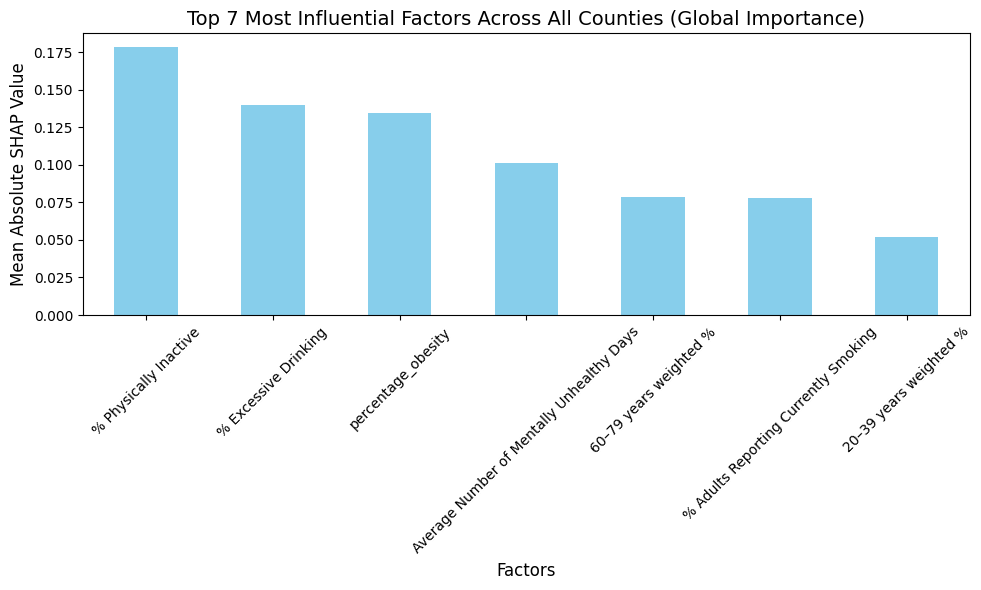

   id_def                    Most Influential Factor
0    1001                     60–79 years weighted %
1    1003                         percentage_obesity
2    1005                       % Excessive Drinking
3    1007                      % Physically Inactive
4    1009  Average Number of Mentally Unhealthy Days


In [19]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert SHAP values into a DataFrame
shap_values_df = pd.DataFrame(shap_values.values, columns=X_test.columns, index=X_test.index)

# Remove 'lat' and 'lng' columns if they exist
if 'lat' in shap_values_df.columns and 'lng' in shap_values_df.columns:
    shap_values_df = shap_values_df.drop(['lat', 'lng'], axis=1)

# Calculate the mean absolute SHAP values for each factor
global_factor_importance = shap_values_df.abs().mean().sort_values(ascending=False)

# Select the 7 most influential factors globally
top_7_factors_global = global_factor_importance.head(7)

# Create a bar chart to visualize these factors
plt.figure(figsize=(10, 6))
top_7_factors_global.plot(kind='bar', color='skyblue')
plt.title('Top 7 Most Influential Factors Across All Counties (Global Importance)', fontsize=14)
plt.xlabel('Factors', fontsize=12)
plt.ylabel('Mean Absolute SHAP Value', fontsize=12)
plt.xticks(rotation=45, fontsize=10)
plt.tight_layout()
plt.show()

# Find the most influential feature for each county
most_influential_factors = shap_values_df.abs().idxmax(axis=1)
X_test_with_factors = X_test.copy()
X_test_with_factors['Most Influential Factor'] = most_influential_factors

# Add the 'id_def' column if it exists in the original data
if 'id_def' in train_data.columns:
    X_test_with_factors = X_test_with_factors.merge(
        train_data[['id_def']],
        left_index=True,
        right_index=True,
        how='left'
    )

# Display the results for each county
print(X_test_with_factors[['id_def', 'Most Influential Factor']].head())

# Save for later analysis
X_test_with_factors.to_csv("county_influential_factors_DEF.csv", index=False)






Occurrences of 'Most Influential Factors':
Most Influential Factor
% Physically Inactive                        1089
% Excessive Drinking                          917
percentage_obesity                            557
60–79 years weighted %                        296
Average Number of Mentally Unhealthy Days     192
20–39 years weighted %                         45
Black/African American%                        27
% Adults Reporting Currently Smoking           27
Name: count, dtype: int64


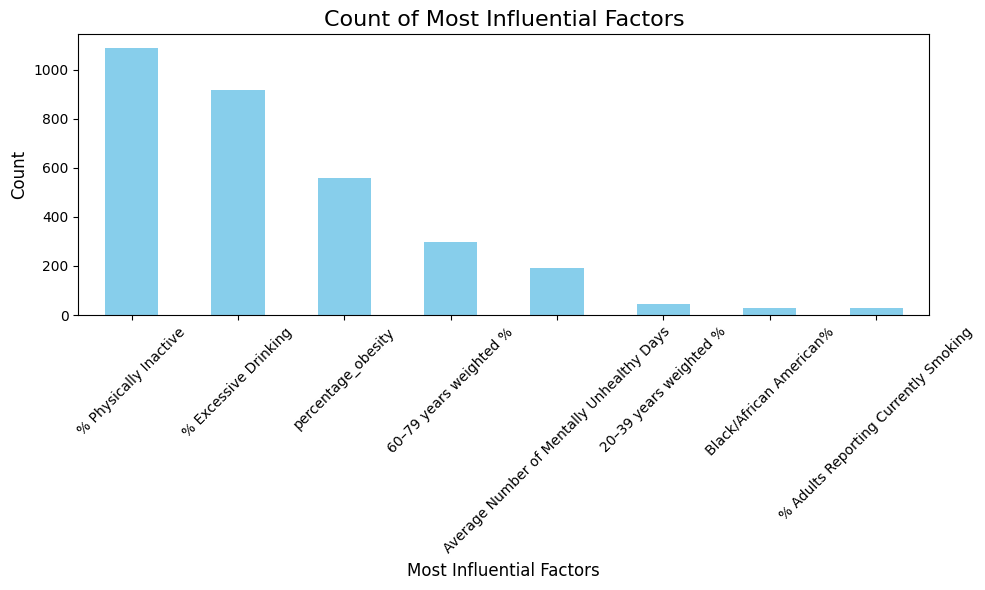

In [20]:
import pandas as pd

# Load the table
county_factors = pd.read_csv("county_influential_factors_DEF.csv")

# Check if the 'Most Influential Factor' column exists
if 'Most Influential Factor' in county_factors.columns:
    # Count the occurrences of each factor type
    factor_counts = county_factors['Most Influential Factor'].value_counts()

    # Display the results
    print("Occurrences of 'Most Influential Factors':")
    print(factor_counts)

    # Optional visualization with a bar plot
    import matplotlib.pyplot as plt
    factor_counts.plot(kind='bar', figsize=(10, 6), color='skyblue')
    plt.title("Count of Most Influential Factors", fontsize=16)
    plt.xlabel("Most Influential Factors", fontsize=12)
    plt.ylabel("Count", fontsize=12)
    plt.xticks(rotation=45, fontsize=10)
    plt.tight_layout()
    plt.show()
else:
    print("The column 'Most Influential Factor' does not exist in the table.")



In [21]:
import pandas as pd

# Load the files
path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/"
geo_data = pd.read_csv(path + "us_county_latlng.csv")  # Geographic data
county_factors = pd.read_csv(path + "county_influential_factors_DEF.csv")  # Influential factors

# Rename columns to match
county_factors = county_factors.rename(columns={'id_def': 'fips_code'})

# Merge geographic data with influential factors
merged_data = geo_data.merge(county_factors, on='fips_code')

# Check the results
print(merged_data.head())




   fips_code         name      lng_x      lat_x  % Physically Inactive  \
0       1059     Franklin -87.843283  34.442381               1.176433   
1      13111       Fannin -84.319296  34.864126               0.144691   
2      19109      Kossuth -94.206898  43.204140              -0.302397   
3      40115       Ottawa -94.810589  36.835878               1.898653   
4      42115  Susquehanna -75.800905  41.821277              -0.405571   

   Average Number of Mentally Unhealthy Days  percentage_obesity  \
0                                   1.149969            0.505383   
1                                   0.869181           -1.423953   
2                                  -0.975521            0.389158   
3                                   0.978654            1.714124   
4                                   0.364846           -0.052497   

   60–79 years weighted %  Black/African American%  % Excessive Drinking  ...  \
0               -0.511470                -0.366974             -1

In [22]:
from IPython.display import display
from folium import Map, CircleMarker, Popup
import folium

# Create a map centered on the United States
us_map = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Add counties with their most influential factors
for _, row in merged_data.iterrows():
    popup_text = f"""
    <b>County:</b> {row['fips_code']}<br>
    <b>Most Influential Factor:</b> {row['Most Influential Factor']}
    """
    folium.CircleMarker(
        location=[row['lat_y'], row['lng_y']],
        radius=5,
        popup=Popup(popup_text, max_width=300),
        color='blue',
        fill=True,
        fill_opacity=0.6
    ).add_to(us_map)

# Display directly in Colab
from IPython.display import HTML
HTML(us_map._repr_html_())




In [23]:
import folium
from folium import Map, CircleMarker, Popup
from IPython.display import HTML

# Associate colors with each factor
factor_colors = {
    '% Adults Reporting Currently Smoking': 'red',
    'percentage_obesity': 'blue',
    'Food Environment Index': 'green',
    '% Physically Inactive': 'orange',
    '% Excessive Drinking': 'purple',
    'pop_insured_in%': 'pink',
    '% Completed High School': 'yellow',
    'Income Ratio': 'cyan',
    '% air pollution': 'brown',
    'Average Number of Mentally Unhealthy Days': 'darkblue',
    'Black/African American%': 'darkred',
    'American Indian/Alaska Native%': 'darkgreen',
    'Asian%': 'darkorange',
    '% Hispanic': 'darkpurple',
    'White%': 'lightblue',
    '20–39 years weighted %': 'lightgreen',
    '40–59 years weighted %': 'lightpink',
    '60–79 years weighted %': 'lightgray',
    'pop_tot_below_poverty_level_in%': 'darkyellow',
    '% Female': 'black'
}

# Create a map centered on the United States
us_map = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Add counties with colors representing their most influential factors
for _, row in merged_data.iterrows():
    factor = row['Most Influential Factor']
    color = factor_colors.get(factor, 'gray')

    popup_text = f"""
    <b>County:</b> {row['fips_code']}<br>
    <b>Most Influential Factor:</b> {factor}
    """
    folium.CircleMarker(
        location=[row['lat_y'], row['lng_y']],
        radius=5,
        popup=Popup(popup_text, max_width=300),
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6
    ).add_to(us_map)

# Display directly in Colab
HTML(us_map._repr_html_())



In [24]:
import folium
import pandas as pd
import json
from folium.plugins import HeatMap
from IPython.display import display, HTML

# Path to the GeoJSON file
geojson_path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/counties.geojson"

# Load the GeoJSON file
with open(geojson_path) as f:
    us_counties_geojson = json.load(f)

# Load the influential factors data by county
county_influential_factors_path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/county_influential_factors_DEF.csv"
county_influential_factors = pd.read_csv(county_influential_factors_path)

# Define colors for each factor
factor_colors = {
    '% Adults Reporting Currently Smoking': 'red',
    'percentage_obesity': 'blue',
    'Food Environment Index': 'green',
    '% Physically Inactive': 'orange',
    '% Excessive Drinking': 'purple',
    'pop_insured_in%': 'pink',
    '% Completed High School': 'yellow',
    'Income Ratio': 'cyan',
    '% air pollution': 'brown',
    'Average Number of Mentally Unhealthy Days': 'darkblue',
    'Black/African American%': 'darkred',
    'American Indian/Alaska Native%': 'darkgreen',
    'Asian%': 'darkorange',
    '% Hispanic': 'darkpurple',
    'White%': 'lightblue',
    '20–39 years weighted %': 'lightgreen',
    '40–59 years weighted %': 'lightpink',
    '60–79 years weighted %': 'lightgray',
    'pop_tot_below_poverty_level_in%': 'darkyellow',
    '% Female': 'black'
}

# Create a map centered on the United States
m = folium.Map(location=[37.8, -96], zoom_start=4)

# Add a choropleth to color the counties
for county in us_counties_geojson['features']:
    geoid = county['properties']['GEOID']  # GEOID in the GeoJSON file
    county_data = county_influential_factors[county_influential_factors['id_def'] == int(geoid)]  # Merge via id_def

    if not county_data.empty:
        # Find the dominant factor and its color
        dominant_factor = county_data['Most Influential Factor'].values[0]
        fill_color = factor_colors.get(dominant_factor, "grey")
    else:
        fill_color = "white"  # Default for counties not found

    # Add the counties with the corresponding color
    folium.GeoJson(
        county,
        style_function=lambda x, fill_color=fill_color: {
            'fillColor': fill_color,
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': 0.6
        }
    ).add_to(m)

# Add a legend to the map
legend_html = '''
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 200px; height: 300px;
            background-color: white; z-index:9999; font-size:14px;
            border:1px solid black; padding: 10px;">
<strong>Legend</strong><br>
<ul style="list-style: none; padding-left: 0;">
    <li><span style="background: red; width: 10px; height: 10px; display: inline-block;"></span> Smoking</li>
    <li><span style="background: blue; width: 10px; height: 10px; display: inline-block;"></span> Obesity</li>
    <li><span style="background: green; width: 10px; height: 10px; display: inline-block;"></span> Food Index</li>
    <li><span style="background: orange; width: 10px; height: 10px; display: inline-block;"></span> Physical Inactivity</li>
    <li><span style="background: purple; width: 10px; height: 10px; display: inline-block;"></span> Excessive Drinking</li>
    <li><span style="background: pink; width: 10px; height: 10px; display: inline-block;"></span> Insured Population</li>
    <li><span style="background: yellow; width: 10px; height: 10px; display: inline-block;"></span> High School Completion</li>
    <li><span style="background: cyan; width: 10px; height: 10px; display: inline-block;"></span> Income Ratio</li>
    <li><span style="background: brown; width: 10px; height: 10px; display: inline-block;"></span> Air Pollution</li>
    <li><span style="background: darkblue; width: 10px; height: 10px; display: inline-block;"></span> Unhealthy Days</li>
    <li><span style="background: darkred; width: 10px; height: 10px; display: inline-block;"></span> Black Population</li>
</ul>
</div>
'''

m.get_root().html.add_child(folium.Element(legend_html))

# Save the map to an HTML file
m.save("map_with_legend.html")

# Display the map in the notebook
display(m)





In [25]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

# Global feature importances from the XGBoost model
feature_importances = best_xgb_model.feature_importances_

# Define selected features (replace with your actual selected features)
# Assuming selected_features_aic or selected_features_bic from previous code
selected_features = ['% Adults Reporting Currently Smoking', 'percentage_obesity', 'Food Environment Index', '% Physically Inactive',
                     '% Excessive Drinking', 'pop_insured_in%', '% Completed High School', 'Income Ratio', '% air pollution',
                     'Average Number of Mentally Unhealthy Days', 'Black/African American%', 'American Indian/Alaska Native%',
                     'White%', '20–39 years weighted %', '40–59 years weighted %',
                     '60–79 years weighted %', 'pop_tot_below_poverty_level_in%', '% Female']

# Load the factors data for each county
factors_per_county = county_influential_factors[selected_features + ['id_def']]

# Normalize feature importances for each county
normalized_importances = factors_per_county[selected_features].copy()
for factor in selected_features:
    normalized_importances[factor] *= feature_importances[selected_features.index(factor)]

# Normalize importances within each county (sum = 1)
normalized_importances = normalized_importances.div(normalized_importances.sum(axis=1), axis=0)

# Add county identifiers for county-level analysis
normalized_importances['id_def'] = factors_per_county['id_def']

# Summary: Percentage of secondary factors' contributions
normalized_importances['Secondary Contribution'] = normalized_importances.sum(axis=1) - normalized_importances.max(axis=1)

# Top counties with high secondary factor contributions
top_secondary_counties = normalized_importances.nlargest(10, 'Secondary Contribution')

print("Top counties with high secondary contributions:")
print(top_secondary_counties[['id_def', 'Secondary Contribution']])



Top counties with high secondary contributions:
   id_def  Secondary Contribution
0    1001                     1.0
1    1003                     1.0
2    1005                     1.0
3    1007                     1.0
4    1009                     1.0
5    1011                     1.0
6    1013                     1.0
7    1015                     1.0
8    1017                     1.0
9    1019                     1.0


Number of counties per dominant factor:
Dominant Factor
% Physically Inactive                        1089
% Excessive Drinking                          917
percentage_obesity                            557
60–79 years weighted %                        296
Average Number of Mentally Unhealthy Days     192
20–39 years weighted %                         45
Black/African American%                        27
% Adults Reporting Currently Smoking           27
Name: count, dtype: int64


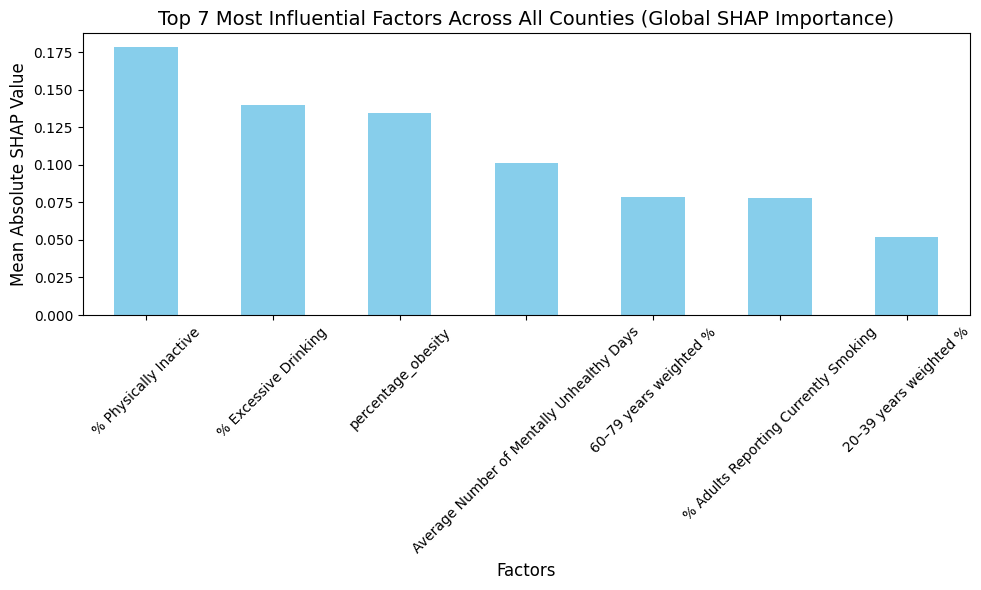

In [26]:
import shap
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import json

# Recalculate SHAP values
explainer = shap.Explainer(best_xgb_model, X_train)  # Replace 'best_Grf_model' with your selected model
shap_values = explainer(X_test)  # Compute SHAP values for the test data

# Convert SHAP values into a DataFrame
shap_values_df = pd.DataFrame(shap_values.values, columns=X_test.columns, index=X_test.index)

# Remove unnecessary columns ('lat' and 'lng') if they exist
if 'lat' in shap_values_df.columns and 'lng' in shap_values_df.columns:
    shap_values_df = shap_values_df.drop(['lat', 'lng'], axis=1)

# Compute deviation metrics (max_diff and std_importance)
def calculate_metrics(row):
    sorted_importances = sorted(row.abs(), reverse=True)  # Sort SHAP values by absolute magnitude
    max_diff = sorted_importances[0] - sorted_importances[1]  # Difference between the 1st and 2nd factor
    std_importance = row.abs().std()  # Standard deviation of factor importances
    dominant_factor = row.abs().idxmax()  # Most dominant factor
    return pd.Series({
        'max_diff': max_diff,
        'std_importance': std_importance,
        'Dominant Factor': dominant_factor
    })

metrics = shap_values_df.apply(calculate_metrics, axis=1)

# Add county identifiers if present in the data
metrics = metrics.reset_index()
metrics = metrics.rename(columns={'index': 'id_def'})

# Count the number of points by dominant factor
dominant_factor_counts = metrics['Dominant Factor'].value_counts()

# Display the counts for each dominant factor
print("Number of counties per dominant factor:")
print(dominant_factor_counts)

# Visualization of results (scatter plot)
geojson_path = "/content/drive/My Drive/ML_EARTH_PROJECT_DATA_2021/counties.geojson"  # Replace with your path if needed
with open(geojson_path) as f:
    counties_geojson = json.load(f)

geojson_df = pd.DataFrame([
    {'id_def': int(feature['properties']['GEOID']), 'county_name': feature['properties']['NAME']}
    for feature in counties_geojson['features']
])


# Merge metrics with county names
merged_metrics = metrics.merge(geojson_df, on='id_def', how='left')

# Create an interactive scatter plot with Plotly
fig = px.scatter(
    merged_metrics,
    x='max_diff',
    y='std_importance',
    color='Dominant Factor',
    hover_data=['county_name', 'id_def'],
    title="Analysis of Gaps Between the Dominant Factor and Other Factors (SHAP values)",
    labels={
        'max_diff': "Difference Between the Dominant Factor and the Second Factor",
        'std_importance': "Standard Deviation of SHAP Values"
    },
    color_discrete_map={
        'percentage_obesity': 'blue',
        '% Physically Inactive': 'orange',
        '% Excessive Drinking': 'purple',
        'Black/African American%': 'darkred',
        'Average Number of Mentally Unhealthy Days': 'darkblue',
        '% Adults Reporting Currently Smoking': 'red',
        '60–79 years weighted %': 'lightgreen'
    }
)

# Add the number of points for each color in the legend
fig.for_each_trace(lambda trace: trace.update(name=f"{trace.name} ({dominant_factor_counts[trace.name]} points)"))

fig.update_traces(marker=dict(size=8, line=dict(width=1, color='black')))
fig.update_layout(
    title_font_size=18,
    xaxis_title_font_size=14,
    yaxis_title_font_size=14,
    legend_title_text='Dominant Factor',
    legend_title_font_size=12
)

fig.show()

# Visualization of bar chart for the top 7 most influential factors globally
global_factor_importance = shap_values_df.abs().mean().sort_values(ascending=False)

plt.figure(figsize=(10, 6))
global_factor_importance.head(7).plot(kind='bar', color='skyblue')
plt.title('Top 7 Most Influential Factors Across All Counties (Global SHAP Importance)', fontsize=14)
plt.xlabel('Factors', fontsize=12)
plt.ylabel('Mean Absolute SHAP Value', fontsize=12)
plt.xticks(rotation=45, fontsize=10)
plt.tight_layout()
plt.show()





In [27]:
# Display the column names in X_test
print("Column names in X_test:")
print(X_test.columns.tolist())



Column names in X_test:
['% Physically Inactive', 'Average Number of Mentally Unhealthy Days', 'percentage_obesity', '60–79 years weighted %', 'Black/African American%', '% Excessive Drinking', '40–59 years weighted %', '% air pollution', 'American Indian/Alaska Native%', '% Female', '% Completed High School', 'Food Environment Index', 'Income Ratio', '% Adults Reporting Currently Smoking', 'pop_insured_in%', 'White%', '20–39 years weighted %', 'lat', 'lng']


<Figure size 1200x600 with 0 Axes>

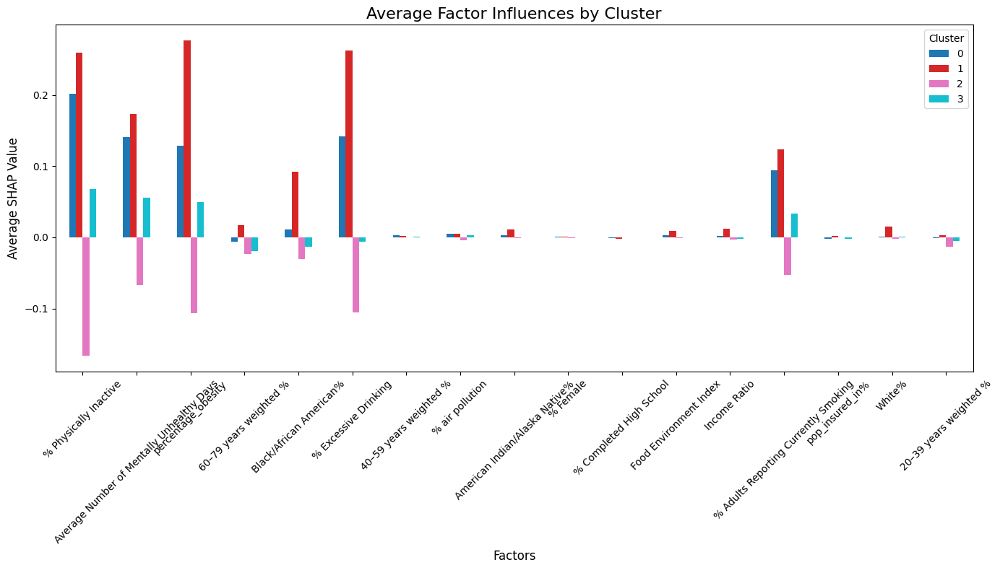

In [28]:
# Necessary imports
import shap
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import folium
from IPython.display import display

# Step 1: Initialize and recalculate SHAP values
explainer = shap.Explainer(best_xgb_model, X_train)
shap_values = explainer(X_test)  # SHAP values for the test data (2019)

# Convert SHAP values into a DataFrame
shap_values_df = pd.DataFrame(shap_values.values, columns=X_test.columns, index=X_test.index)

# Remove 'lat' and 'lng' columns if they exist
if 'lat' in shap_values_df.columns and 'lng' in shap_values_df.columns:
    shap_values_df = shap_values_df.drop(['lat', 'lng'], axis=1)

# Step 2: Find the 7 most influential factors for each county
top_7_factors_per_county = shap_values_df.abs().apply(lambda row: row.nlargest(7).index.tolist(), axis=1)
top_7_shap_values_per_county = shap_values_df.apply(lambda row: row.nlargest(7).values, axis=1)

# Create a matrix of SHAP values for the top 7 factors
top_factors_matrix = pd.DataFrame(top_7_shap_values_per_county.tolist(), index=shap_values_df.index)
top_factors_matrix.columns = [f"Factor_{i+1}" for i in range(1, 8)]

# Step 3: Standardize the data for clustering
scaler = StandardScaler()
top_factors_scaled = scaler.fit_transform(top_factors_matrix)

# Step 4: Perform clustering with K-means
optimal_clusters = 4  # Determined using the Elbow Method
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
top_factors_matrix['Cluster'] = kmeans.fit_predict(top_factors_scaled)

# Step 5: Analyze the average characteristics of the clusters
cluster_characteristics = shap_values_df.groupby(top_factors_matrix['Cluster']).mean()

# Step 6: Visualize the average factor influences by cluster
plt.figure(figsize=(12, 6))
cluster_characteristics.T.plot(kind='bar', figsize=(14, 8), colormap='tab10')
plt.title("Average Factor Influences by Cluster", fontsize=16)
plt.ylabel("Average SHAP Value", fontsize=12)
plt.xlabel("Factors", fontsize=12)
plt.legend(title="Cluster", fontsize=10)
plt.xticks(rotation=45, fontsize=10)
plt.tight_layout()
plt.show()

# Step 7: Visualize clusters on a map

# Add latitude and longitude from the original data
if 'lat' in X_test.columns and 'lng' in X_test.columns:
    top_factors_matrix['lat'] = X_test['lat']
    top_factors_matrix['lng'] = X_test['lng']

# Create a map centered on the United States
m = folium.Map(location=[37.8, -96], zoom_start=4)

# Define cluster information based on the results and the provided graph
cluster_info_dict = {
    0: {
        'color': '#000080',  # Navy Blue
        'description': "Dominated by physical inactivity, with moderate influences from mental health issues and obesity. These regions require interventions to promote physical activity and manage stress."
    },
    1: {
        'color': '#FF0000',  # Bright Red
        'description': "Strong influence of excessive alcohol consumption and physical inactivity, with moderate contributions from smoking. These regions require educational campaigns to address risky behaviors."
    },
    2: {
        'color': '#FFC0CB',  # Light Pink
        'description': "Low or negative influence of most factors. These regions appear to have a balanced health profile and could serve as benchmarks for public health best practices."
    },
    3: {
        'color': '#00CED1',  # Cyan
        'description': "Dominated by obesity and physical inactivity, with moderate contributions from mental health issues and smoking. These regions reflect complex lifestyle-related health challenges."
    }
}

# Add markers for each county
for _, row in top_factors_matrix.iterrows():
    cluster_id = row['Cluster']
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=5,
        color=cluster_info_dict[cluster_id]['color'],
        fill=True,
        fill_opacity=0.6,
        popup=(
            f"Cluster: {cluster_id}<br>"
            f"Top Factors: {', '.join(top_7_factors_per_county.loc[row.name])}"
        )
    ).add_to(m)

# Create an HTML legend to integrate into the Folium map
legend_html = """
<div style="
position: fixed;
bottom: 50px; left: 50px; width: 350px; height: 220px;
z-index: 1000; background-color: white; padding: 13px; border: 2px solid black; font-size: 9px;">
<b>Cluster Legend:</b><br>
<span style="color:#000080; font-weight: bold;">Cluster 0 (Navy Blue):</span> Dominated by physical inactivity, with moderate influences from mental health issues and obesity. These regions require interventions to promote physical activity and manage stress.<br><br>
<span style="color:#FF0000; font-weight: bold;">Cluster 1 (Red):</span> Strong influence of excessive alcohol consumption and physical inactivity, with moderate contributions from smoking. These regions require educational campaigns to address risky behaviors.<br><br>
<span style="color:#FFC0CB; font-weight: bold;">Cluster 2 (Pink):</span> Low or negative influence of most factors. These regions appear to have a balanced health profile and could serve as benchmarks for public health best practices.<br><br>
<span style="color:#00CED1; font-weight: bold;">Cluster 3 (Cyan):</span> Dominated by obesity and physical inactivity, with moderate contributions from mental health issues and smoking. These regions reflect complex lifestyle-related health challenges.<br>
</div>
"""

m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
from IPython.display import HTML
m_html = m._repr_html_()
display(HTML(m_html))

